# Load Data and modules

In [4]:
data_folder = 'data_1000'
url = 'https://www.dropbox.com/s/jw37bgqn7thh0he/20220831_Knee_joint_simulation.zip?dl=1'

# # used settings
# periodicity = 100
# number_steps = 1000
# limit_plot = 1000
# overwrite = False
# redo = False

# do_image_plots = True

In [5]:
RunningInCOLAB = 'google.colab' in str(get_ipython()) if hasattr(__builtins__,'__IPYTHON__') else False

if RunningInCOLAB:
    ## just the python file
    # !wget -O data.zip https://www.dropbox.com/s/s3r30usguzkk362/knee_joints.py.zip?dl=0
    # !unzip data.zip -d ./

    !wget -O data.zip {url}
    !unzip data.zip -d ./

    !pip install gudhi
    !apt install imagemagick

    # fix the "can't load if picke_allow=False" error in colab
    import numpy as np
    # save np.load
    np_load_old = np.load
    # modify the default parameters of np.load
    np.load = lambda *a,**k: np_load_old(*a, allow_pickle=True, **k)

else:
    import urllib.request
    import shutil
    from zipfile import ZipFile
    import os
    
    if os.path.isdir(data_folder):
        print("Folder {data_folder} already exists! Didn't download and extract!")
        print("Delete folder and rerun cell if want to re-download etc.!")
    else:
        print('Downloading zip file')
        filename = 'data_temporary.zip'
        urllib.request.urlretrieve(url, filename)

        print('Extracting zip file')
        with ZipFile('./data_temporary.zip', 'r') as zipObj:
            # Extract all the contents of zip file in current directory
            zipObj.extractall('data_temporary')

        print('Moving to right folder')
        if os.path.isdir(f'./data_temporary/{data_folder}'):
            shutil.move(f'./data_temporary/{data_folder}', './')
            shutil.rmtree('./data_temporary/')
        else:
            print("Folder {data_folder} has not been found in the unzipped folder!")

Folder {data_folder} already exists! Didn't download and extract!
Delete folder and rerun cell if want to re-download etc.!


In [59]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.manifold import MDS
from sklearn.preprocessing import MinMaxScaler

import subprocess
import os
from pathlib import Path
import sys

from tqdm import tqdm
from IPython.display import Image

import gudhi as gd
from gudhi.point_cloud.timedelay import TimeDelayEmbedding

from knee_joints import create_fig, diagram_convert, get_distance_matrix, get_max_pw_dist

# Load Data

In [14]:
# create folders
if not os.path.isdir(data_folder):
    os.mkdir(data_folder)

create_folders = ['animation', 'arrays', 'distances', 'images', 'plots', 
                  'tmp_files', 'persistence_diagrams']
for cr_folder in create_folders:
    folderpath = os.path.join(data_folder, cr_folder)
    if not os.path.isdir(folderpath):
        print('Created folder', folderpath)
        os.mkdir(folderpath)

# get folders
folders = []
for item in Path(data_folder, 'arrays').iterdir():
    if (str(item.name).startswith('images_')
       and str(item.name).endswith('.npy')):
        folders.append(item.name)

# sort folders and put 'images_smooth' in 
# first position if it exists
folders.sort()
if 'images_smooth.npy' in folders:
    folders.remove('images_smooth.npy')
    folders.insert(0, 'images_smooth.npy')

samples_all = [(i,
                '_'.join(folders[i].split('_')[1:]),
                np.load(os.path.join(data_folder, 'arrays', f'{folders[i]}')))
               for i in range(len(folders))]

folders = [folder[:-4] for folder in folders]

In [15]:
if os.path.isfile(os.path.join(data_folder, 'distances', 'distances_coords.npz')):
    distances = np.load(os.path.join(data_folder, 'distances',
                                     'distances_coords.npz'))
    distances = distances['distances']
else:
    distances = []
    for k, txt, points_plot in samples_all:
        dist_mat = np.zeros([len(points_plot), len(points_plot)])
        for i in range(len(points_plot)):
            for j in range(i+1, len(points_plot)):
                dist_mat[i, j] = np.linalg.norm(points_plot[i] - points_plot[j])
                dist_mat[j, i] = dist_mat[i, j]
            
        distances.append(dist_mat)

    distances = np.array(distances)
    np.savez_compressed(os.path.join(data_folder, 'distances', 'distances_coords.npz'), 
                        names=[folder for folder in folders],
                        distances=distances)

if os.path.isfile(os.path.join(data_folder, 'distances', 'distances_images.npz')):
    distances_images = np.load(os.path.join(data_folder, 'distances', 'distances_images.npz'))
    names = distances_images['names']
    distances_images = distances_images['distances']
else:
    distances_images = []
    for folder in folders:
        files = os.listdir(os.path.join(data_folder, f'images/{folder}'))
        files.sort()

        print(folder)
        print(' - Read in images')
        images = []
        for file in tqdm(files):
            filepath = os.path.join(data_folder, f'images/{folder}/{file}')
            if filepath.startswith('movement_'): 
                img = skio.imread(filepath)[:, :, :3]
            img = np.uint8(rgb2gray(img))
            images.append(np.array(img < 1, dtype=np.int32))

        print(' - Create distance matrix')
        dist_mat = np.zeros([len(images), len(images)])
        for i in tqdm(range(len(images))):
            for j in range(i+1, len(images)):
                dist_mat[i, j] = np.linalg.norm(images[i] - images[j])
                dist_mat[j, i] = dist_mat[i, j]
            
        distances_images.append(dist_mat)

    distances_images = np.array(distances_images)
    np.savez_compressed(os.path.join(data_folder, 'distances', 'distances_images.npz'),
                        names=[folder for folder in folders],
                        distances=distances_images)

In [27]:
l2_coords = []
for _, _, points_plot in samples_all:
    l2_coords.append([np.linalg.norm(points_plot[i+1] - points_plot[i])
                      for i in range(points_plot.shape[0]-1)])

tc_embed = TimeDelayEmbedding()
pc_taken = tc_embed.transform(l2_coords)

l2 = []
for k, folder in enumerate(folders):
    l2.append([np.linalg.norm(distances_images[k][i+1, i])
               for i in range(len(distances_images[k])-1)])

tc_embed = TimeDelayEmbedding()
pc_taken_img = tc_embed.transform(l2)

# Plots

## Simulation

The simulation are based on a smooth motion which is then changed in different ways.

1. `smooth` - Original
2. `last-point` - The last joint sticks on the sides
3. `last-point-0.01` - The last joint sticks on the sides + random perturbation (something went wrong, the perturbation seems to be too small?)
4. `last-point` - The last joint sticks on the sides + random perturbation (something went wrong, the perturbation seems to be too small?)
5. `noisy_0.01` - smooth motion with noise added in two different strengths
6. `noisy_0.1` - smooth motion with noise added in two different strengths
7. `skip` - skip certain steps in the movement
8. `skip_0.1` - same as skip but with perturbations of the last joint
9. `smooth-quick` - same as smooth but just quicker

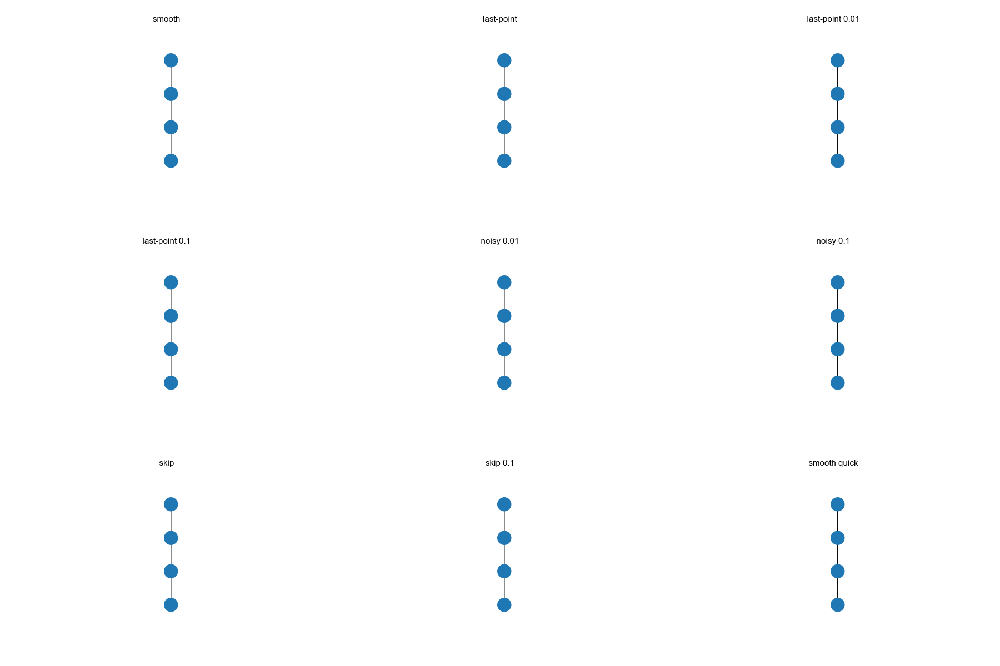

In [1]:
# the different gif animations show the following

from IPython.display import Image
Image(open('./data_1000/animation/anim_all.gif','rb').read())

To find out about the dynamics of the knee-joint in their different scenarios, we consider two different inputs

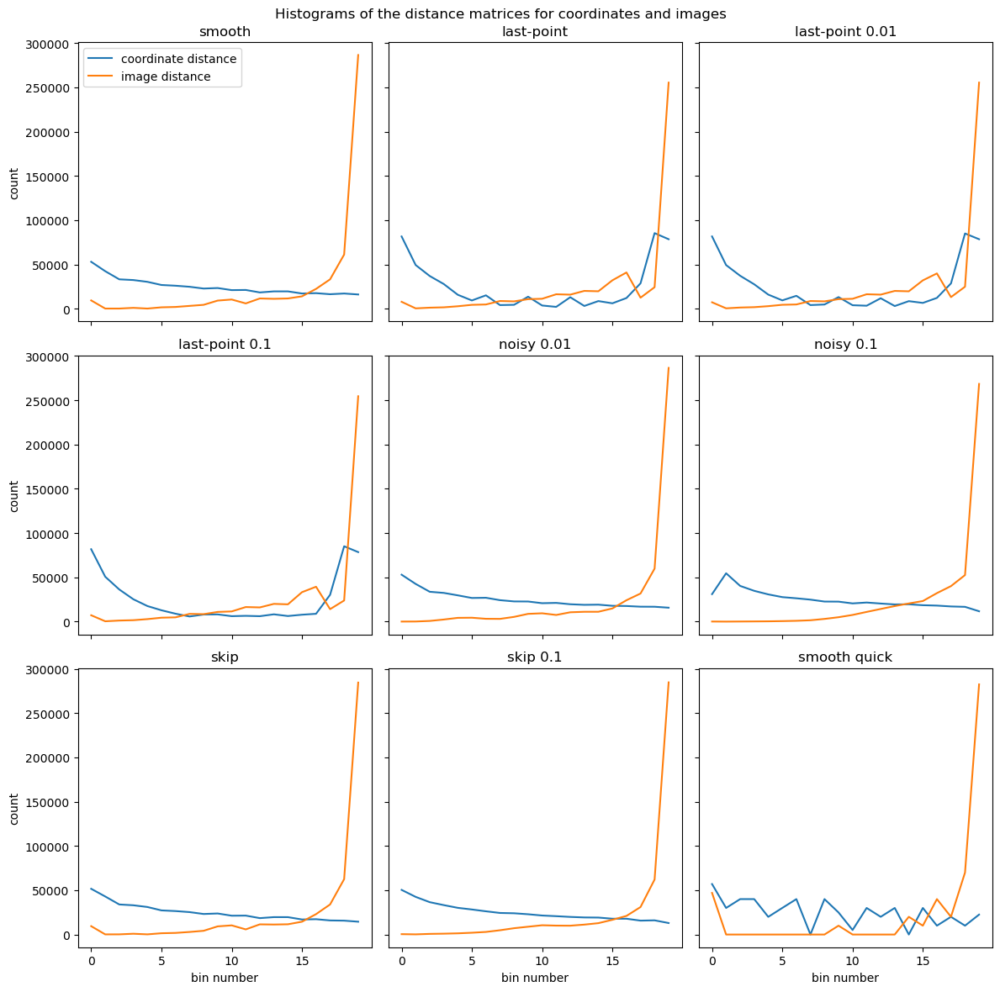

In [22]:
# for i in range(len(pc_taken)):
fig, ax_list, rows, cols = create_fig(samples_all, dpi=100,
                                      return_row_col=True,
                                      sharex=True,
                                      sharey=True)

for i in range(len(distances)):
    # mask = np.ones([len(pc_taken[i]), len(pc_taken[i])])
    # mask = (np.triu(mask, k=1)==1)
    # counts, bins = np.histogram(get_distance_matrix(pc_taken[i])[mask], bins=20)
    # ax_list[i].plot(range(20), counts, label='point distance in taken embedding')

    mask = np.ones(np.shape(distances[i]))
    mask = (np.triu(mask, k=1)==1)
    counts, bins = np.histogram(distances[i][mask], bins=20)
    ax_list[i].plot(range(20), counts, label='coordinate distance')

    mask = np.ones(np.shape(distances_images[i]))
    mask = (np.triu(mask, k=1)==1)
    counts, bins = np.histogram(distances_images[i][mask], bins=20)
    ax_list[i].plot(range(20), counts, label='image distance')

    ax_list[i].set_title(' '.join(folders[i].split('_')[1:]))

    # if the current axis is on the last row
    if i >= (rows - 1)*cols:
        ax_list[i].set_xlabel('bin number')
    # if the current axis is on the first column
    if i % cols == 0:
        ax_list[i].set_ylabel('count')
    ax_list[0].legend()

fig.suptitle('Histograms of the distance matrices for coordinates and images')
fig.tight_layout()
fig.savefig(os.path.join(data_folder, 'plots', f'histogram_{folders[i]}.png'))

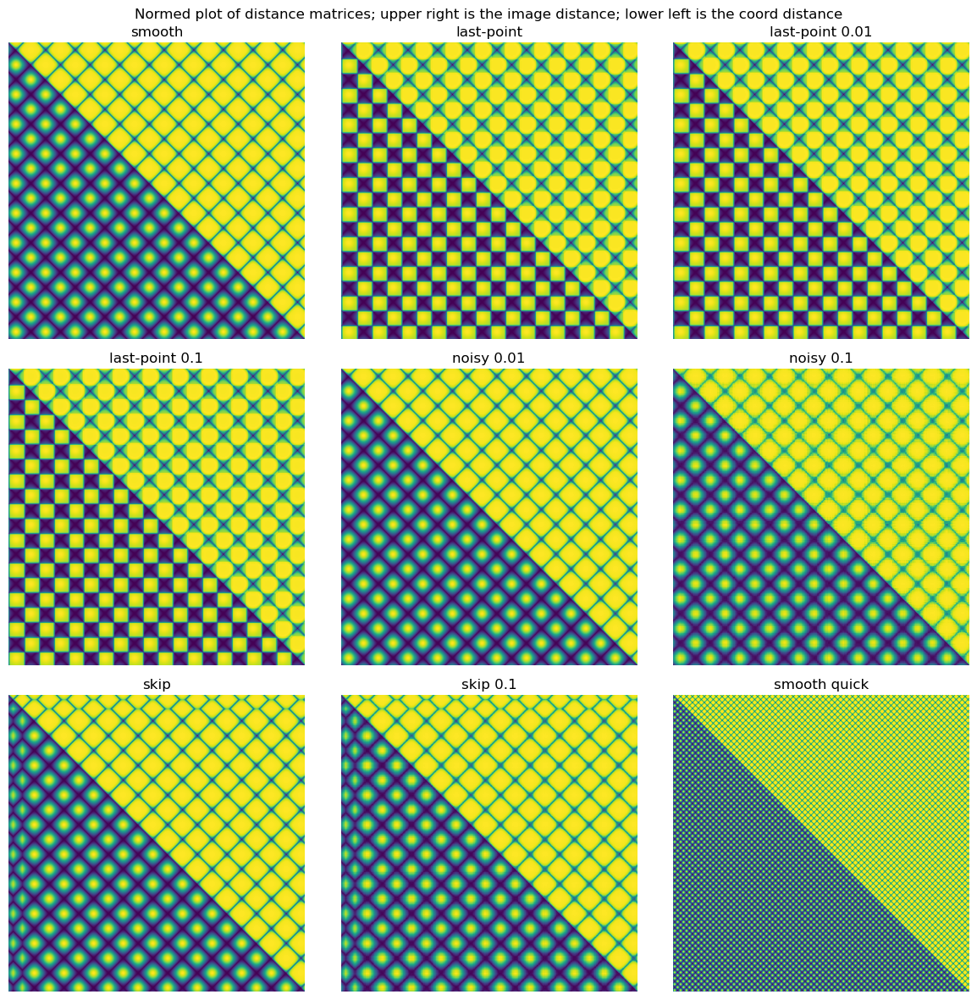

In [24]:
# distance matrices
for i in range(len(distances)):
    if np.shape(distances[i]) != np.shape(distances_images[i]):
        print(np.shape(distances[i]), np.shape(distances_images[i]))
        raise ValueError(f"distance and distance_images are not the same for {i}")

fig, ax_list = create_fig(distances, dpi=100,
                          sharex=True,
                          sharey=True)

for i in range(len(distances)):
    mask = np.ones(np.shape(distances[i]))
    mask = (np.triu(mask, k=1)==1)

    img = (distances[i] - np.min(distances[i][mask])) / (np.max(distances[i][mask]) - np.min(distances[i][mask]))

    tmp = (distances_images[i] - np.min(distances_images[i][mask])) / (np.max(distances_images[i][mask]) - np.min(distances_images[i][mask]))
    img[mask] = tmp[mask]

    ax_list[i].imshow(img)
    ax_list[i].set_title(' '.join(folders[i].split('_')[1:]))
    ax_list[i].axis('off')

fig.suptitle('Normed plot of distance matrices; upper right is the image distance; lower left is the coord distance')
fig.tight_layout()

fig.savefig(os.path.join(data_folder, 'plots', 'distance_matrices_coord-image-distance.png'))

## Coordinates as input for distance calculation

In the following we consider the coordinates of the joint in 2d as being our input for distance calculation. We assume that we have a correspondence function ready to match the right joints with each other.

This represents the "best" case in the analysis, since the distance contains the least amount of noise.





.

First let us start by considering the distance coordinates of consecutive time steps and embed the resulting time series using a time delay embedding.

In the plot we can see the periodicity of all different movements; `noisy` samples have a wider range of small perturbations along their curve.

Here we can see, that while we had trouble distinguishing the `last-point` movement scheme from another, we can see slight difference in the maximal amplitude.

The `smooth_quick` movement has such a quick movement that it looks more like a wide bar.

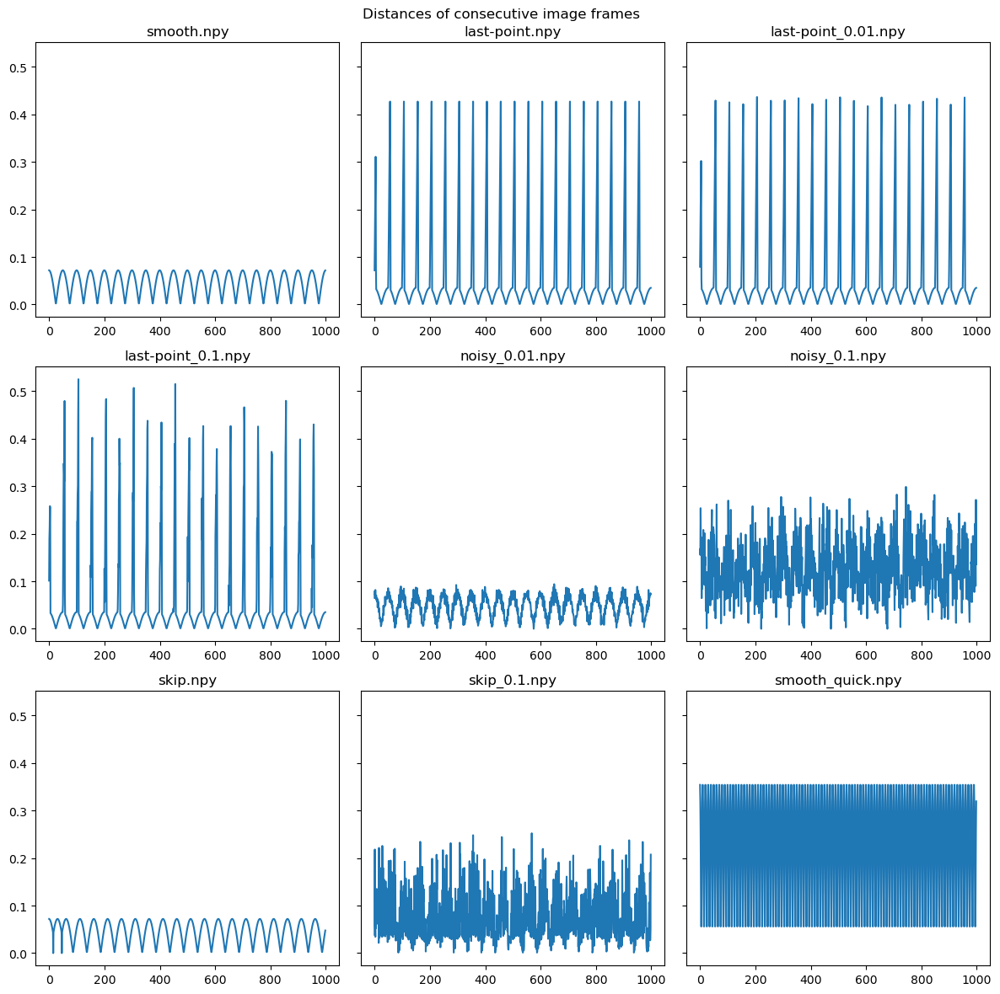

In [28]:
fig, ax_list = create_fig(samples_all, dpi=100, sharey=True)

for i in range(len(samples_all)):
    ax_list[i].plot(range(len(l2_coords[i])), l2_coords[i])
    ax_list[i].set_title(samples_all[i][1])

for i in range(len(samples_all), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Distances of consecutive image frames')
fig.tight_layout()
fig.savefig(os.path.join(data_folder, 'plots', 'coords_distance_bw_consecutive_frames.png'))

Now we plot the time delay embedding. Depending on how periodic the movement is it traces more of a circle or not. The characteristics of the ellipse tell us more about the characteristic of the time series. 

The following plot is with a shared y- and x-axis.

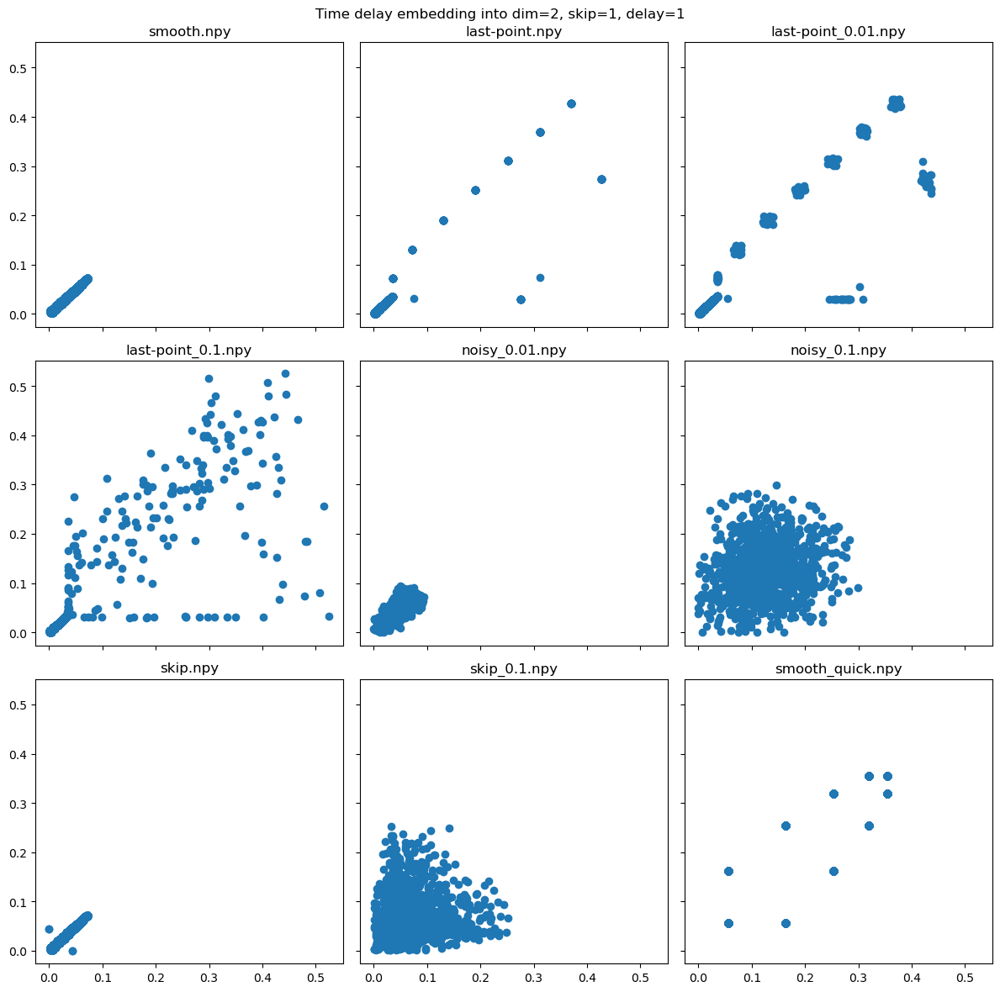

In [33]:
fig, ax_list = create_fig(samples_all, dpi=100, 
                          sharey=True,
                          sharex=True)

for i in range(len(samples_all)):
    ax_list[i].scatter(pc_taken[i][:, 0], pc_taken[i][:, 1])
    ax_list[i].set_title(samples_all[i][1])

for i in range(len(samples_all), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Time delay embedding into dim=2, skip=1, delay=1')
fig.tight_layout()
fig.savefig(os.path.join(data_folder, 'plots', 'coords_time_delay_consecutive_frames.png'))

For a better illustration, we plot the same point clouds as above with different axis dimensions. 

We can clearly see that the noisier the movement is, the more the point cloud looks doesn't have a clear structure (more like a dense point cloud), while some of the other samples trace a clear circle.

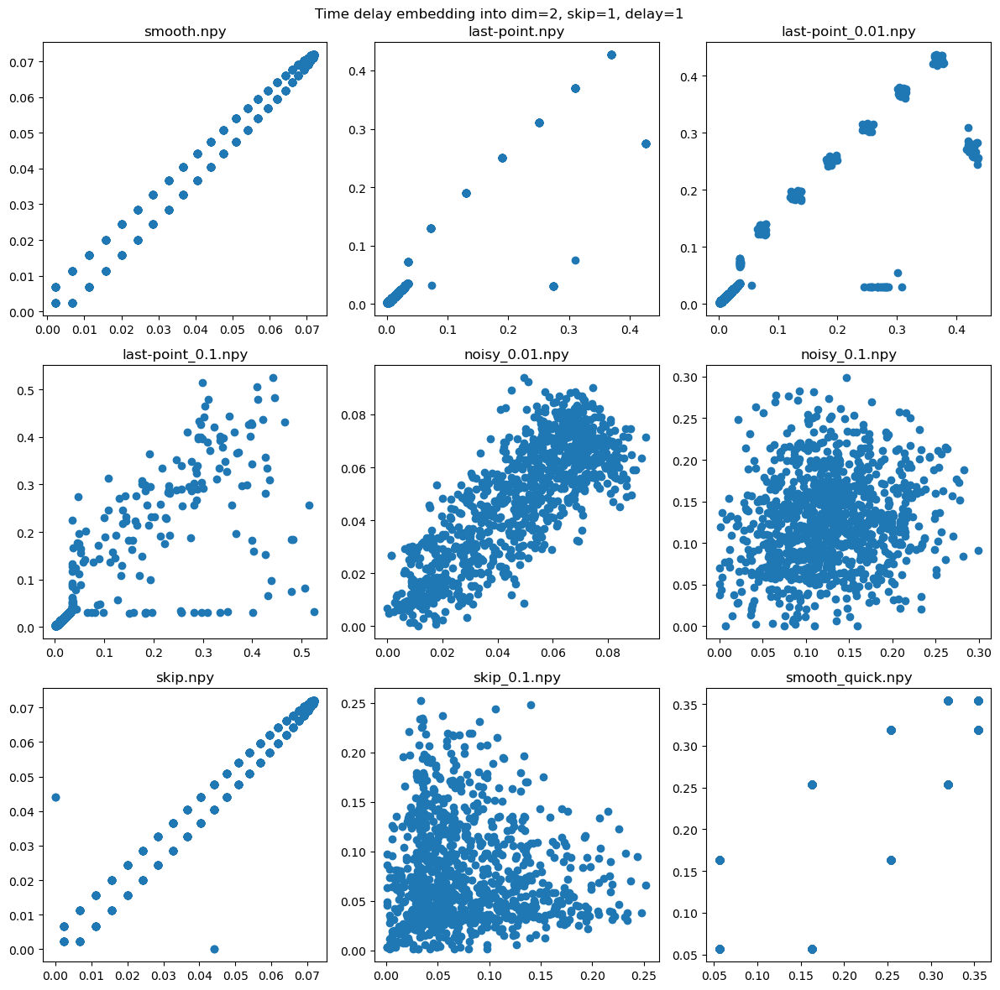

In [30]:
fig, ax_list = create_fig(samples_all, dpi=100)

for i in range(len(samples_all)):
    ax_list[i].scatter(pc_taken[i][:, 0], pc_taken[i][:, 1])
    ax_list[i].set_title(samples_all[i][1])

for i in range(len(samples_all), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Time delay embedding into dim=2, skip=1, delay=1')
fig.tight_layout()
fig.savefig(os.path.join(data_folder, 'plots', 'coords_time_delay_consecutive_frames.png'))

Obvioulsy, we can now calculate the distance of these different point clouds from each other to give us a notion of "how different" samples are from the smooth movement.

More importantly, we want to get a clearer picture of the underlying dynamics and then consider the distance these dynamics from each other.

For that we use [persistence homology](https://www.maths.ed.ac.uk/~v1ranick/papers/edelhare.pdf), which gives us a descriptor about the topology of the point cloud in this example.

There is a plethora of different constructions available. We are just discussing three different combinations:

Different ways to go from a point cloud to a combinatorial structure:
1. The combinatorial structures used are the [Alpha complex](https://gudhi.inria.fr/doc/latest/group__alpha__complex.html) and the [Vietoris-Rips complex](https://comptag.github.io/rpackage_tutorials/2019/07/tda-rips-tutorial.html).
2. Both complexes can be aquired directly from the points of the time delay embedding, since that is already in the Euclidean space.
3. Another alternative for the Vietoris-Rips complex is to consider the differences of the inputs at each time directly and use the resultingh distance matrix for computation.
4. To do the same for the alpha complex, we use MDS to artifically find a point cloud in $R^d$ which is models the distances of the different inputs.

In the following we will plot the resulting persistence diagrams for all these different scenarios and at the end we show the distances between the resulting persistence diagrams of the differen movements.

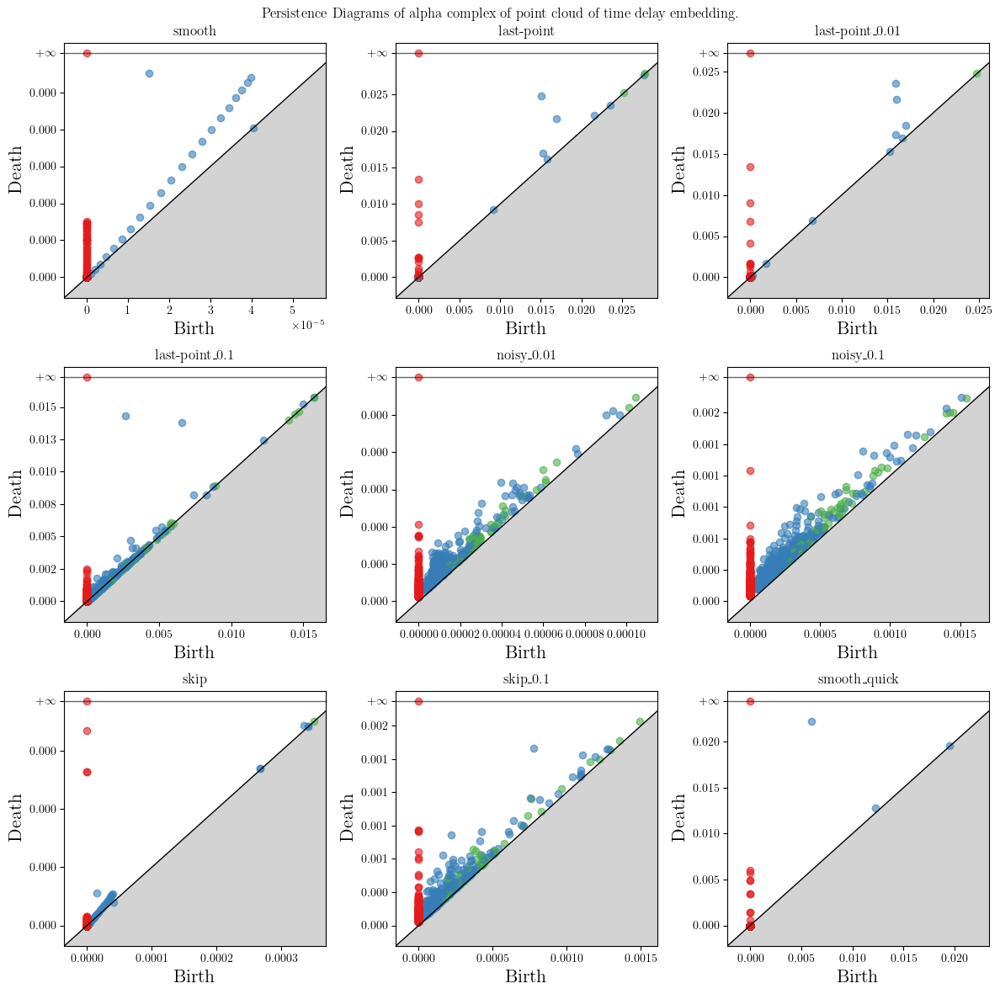

In [35]:
# fig, ax_list = create_fig(samples_all, dpi=200, sharey=True, sharex=True)
fig, ax_list = create_fig(samples_all, dpi=100)

diagrams = np.load(os.path.join(data_folder, 'persistence_diagrams', 
                                'coords_consecutive_alphacomplex.npz'))

for i, key in enumerate(diagrams.keys()):
    dgmX = diagram_convert(diagrams[key])
    gd.plot_persistence_diagram(dgmX, axes=ax_list[i])
    ax_list[i].set_title('_'.join(key.split('_')[1:]))

for i in range(len(diagrams.keys()), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Persistence Diagrams of alpha complex of point cloud of time delay embedding.')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'coords_alpha_timedelay.png'))

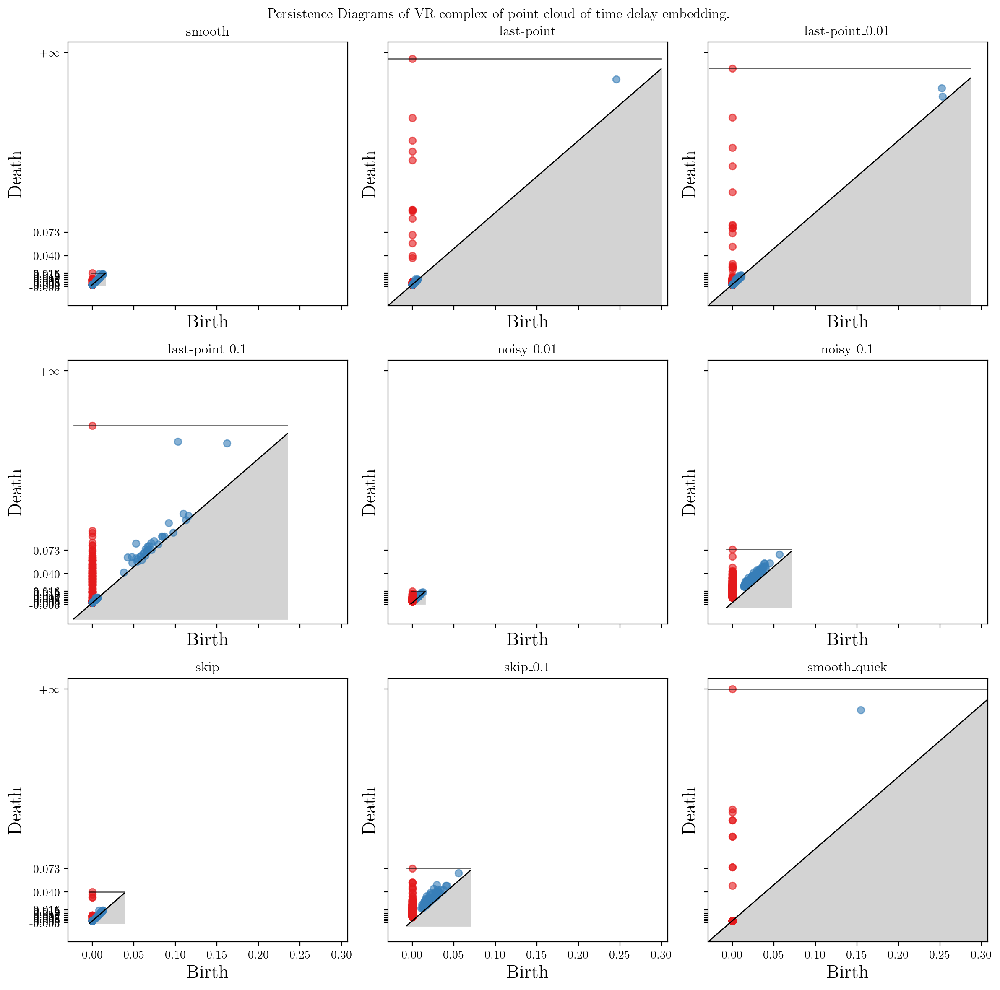

In [36]:
fig, ax_list = create_fig(samples_all, dpi=200, sharey=True, sharex=True)

diagrams = np.load(os.path.join(data_folder, 'persistence_diagrams', 
                                'coords_consecutive_VRcomplex.npz'))

for i, key in enumerate(diagrams.keys()):
    dgmX = diagram_convert(diagrams[key])
    gd.plot_persistence_diagram(dgmX, axes=ax_list[i])
    ax_list[i].set_title('_'.join(key.split('_')[1:]))
    
for i in range(len(diagrams.keys()), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Persistence Diagrams of VR complex of point cloud of time delay embedding.')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'coords_VR_timedelay.png'))

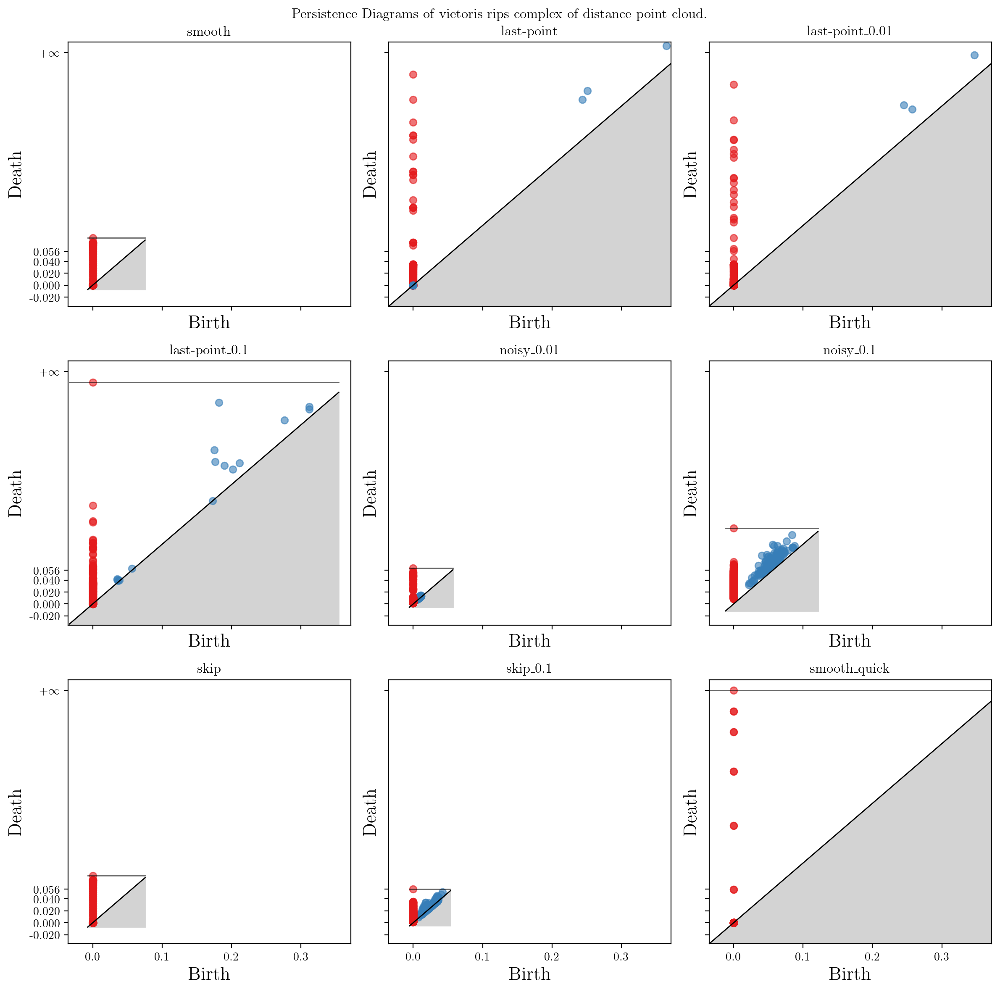

In [37]:
fig, ax_list = create_fig(samples_all, dpi=200, sharey=True, sharex=True)

diagrams = np.load(os.path.join(data_folder, 'persistence_diagrams', 
                                'coords_distmatrix_VRcomplex.npz'))

for i, key in enumerate(diagrams.keys()):
    dgmX = diagram_convert(diagrams[key])
    gd.plot_persistence_diagram(dgmX, axes=ax_list[i])
    ax_list[i].set_title('_'.join(key.split('_')[1:]))

for i in range(len(diagrams.keys()), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Persistence Diagrams of vietoris rips complex'
             + ' of distance point cloud.')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'coords_VR_pwDistances.png'))

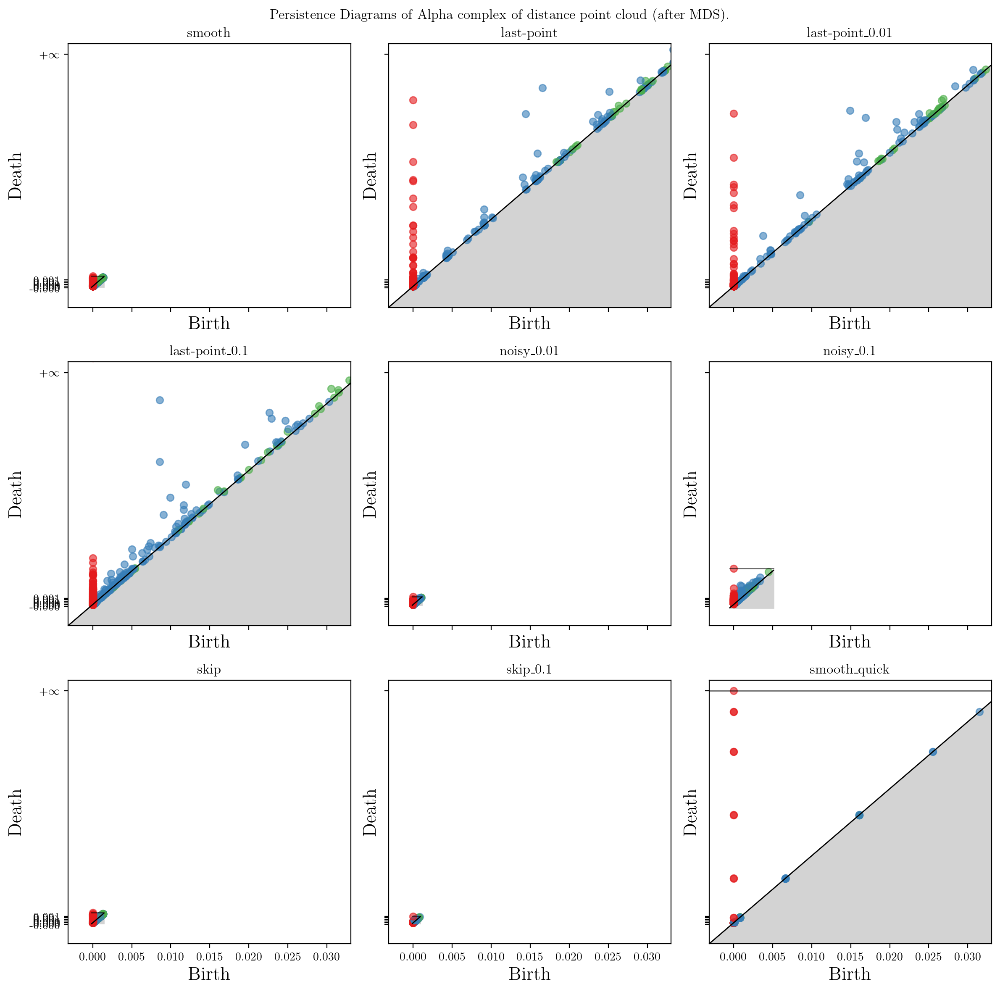

In [38]:
fig, ax_list = create_fig(samples_all, dpi=200, sharey=True, sharex=True)

diagrams = np.load(os.path.join(data_folder, 'persistence_diagrams', 
                                'coords_distmatrix_alphacomplex.npz'))

for i, key in enumerate(diagrams.keys()):
    dgmX = diagram_convert(diagrams[key])
    gd.plot_persistence_diagram(dgmX, axes=ax_list[i])
    ax_list[i].set_title('_'.join(key.split('_')[1:]))

for i in range(len(diagrams.keys()), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Persistence Diagrams of Alpha complex'
             + ' of distance point cloud (after MDS).')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'coords_alpha_pwDistances.png'))

## Images as input for distance calculation

Right now we plot the same images as in the case of the coordinates being used for distance calculation;
The only difference is that we now take images we plotted using `networkx` as inputs. 

This is used to emulate a pipeline using fuzzy data.

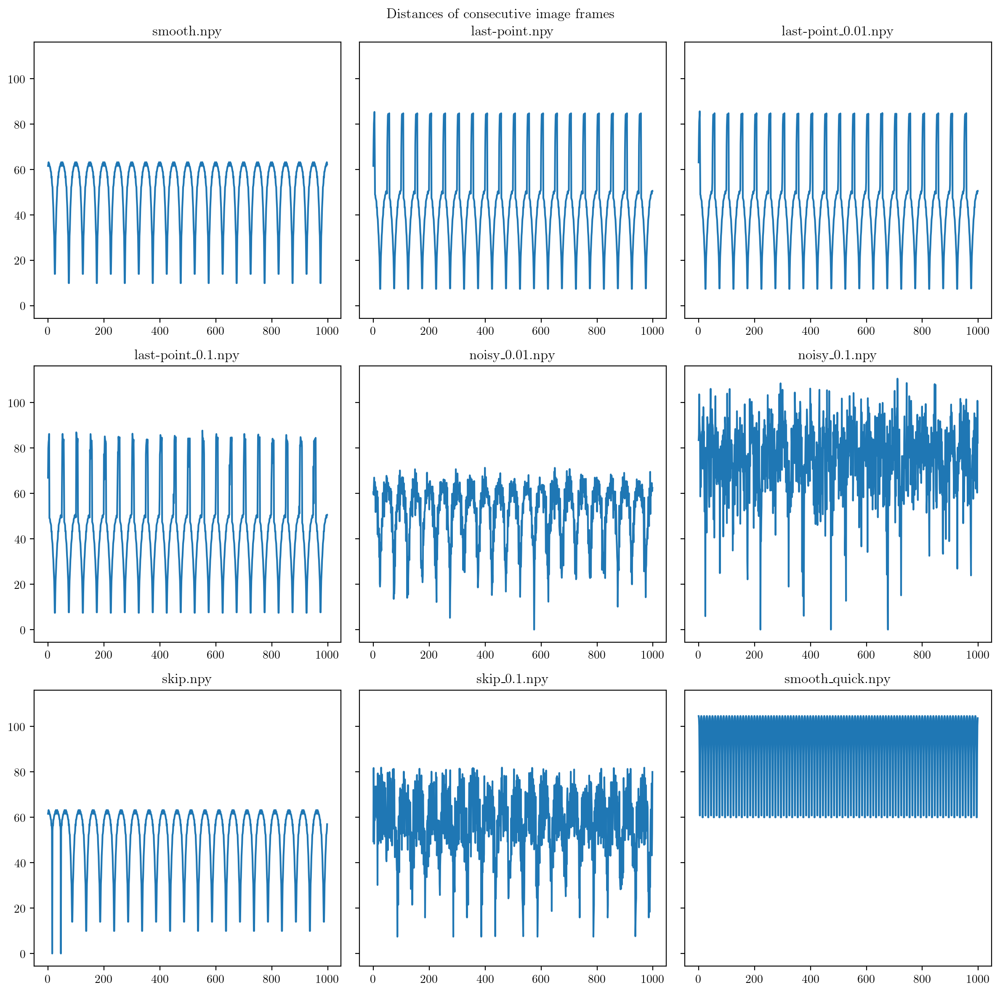

In [40]:
fig, ax_list = create_fig(samples_all, dpi=200, sharey=True)

for i in range(len(samples_all)):
    ax_list[i].plot(range(len(l2[i])), l2[i])
    ax_list[i].set_title(samples_all[i][1])

for i in range(len(samples_all), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Distances of consecutive image frames')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'img_distance_bw_consecutive_frames.png'))

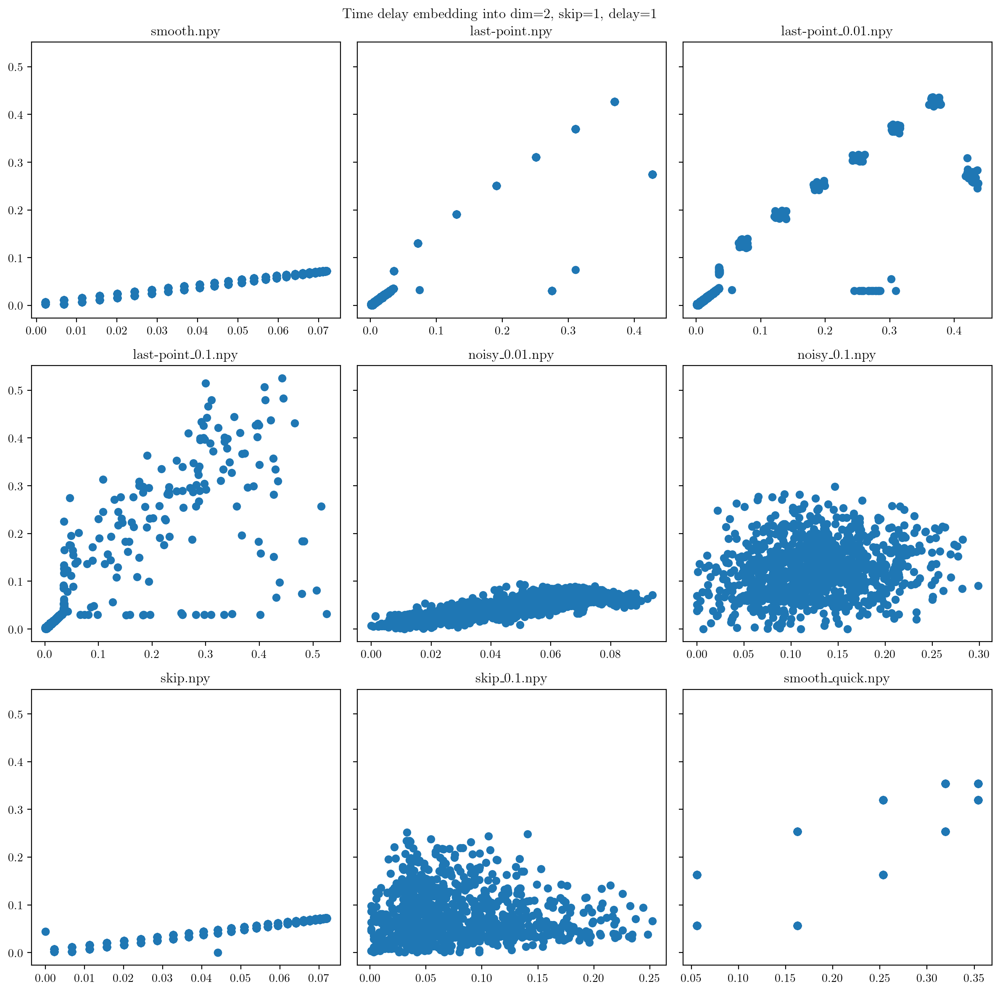

In [41]:
fig, ax_list = create_fig(samples_all, dpi=200, sharey=True)

for i in range(len(samples_all)):
    ax_list[i].scatter(pc_taken[i][:, 0], pc_taken[i][:, 1])
    ax_list[i].set_title(samples_all[i][1])

for i in range(len(samples_all), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Time delay embedding into dim=2, skip=1, delay=1')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'img_time_delay_consecutive_frames.png'))

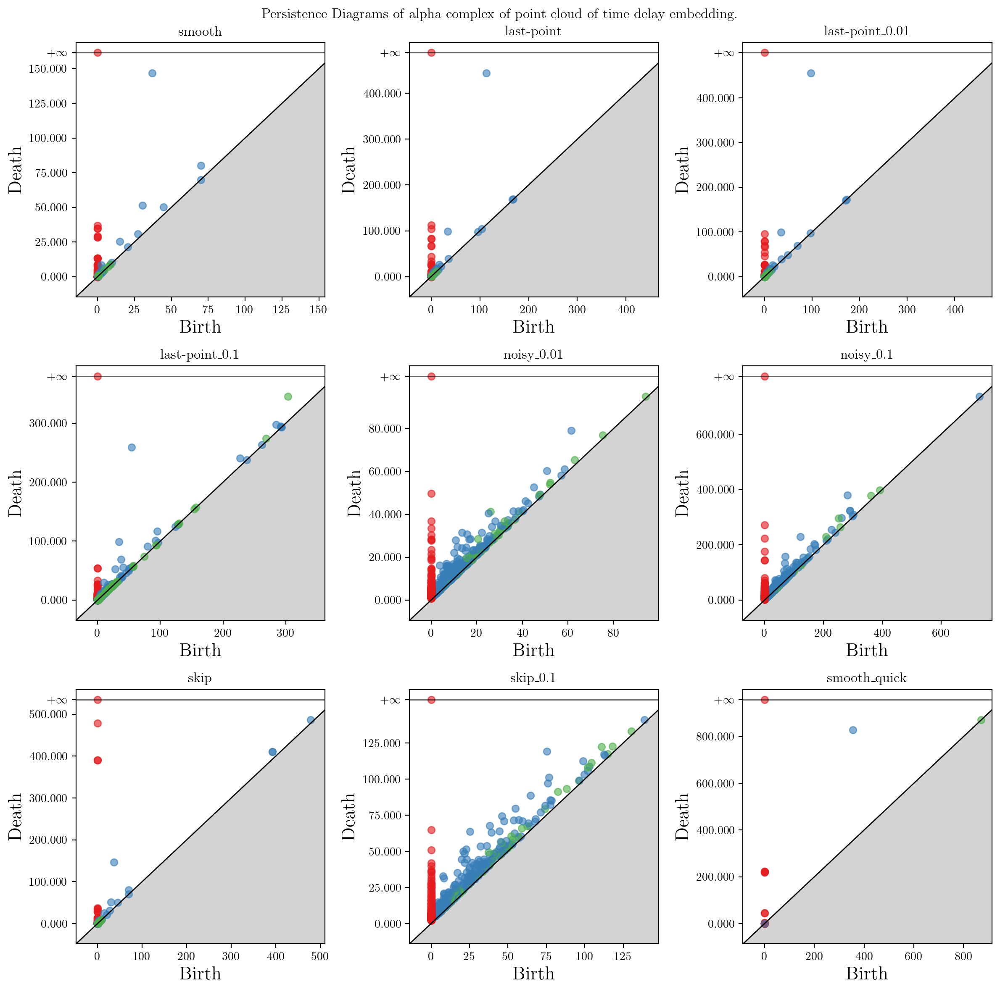

In [42]:
# fig, ax_list = create_fig(samples_all, dpi=200, sharey=True, sharex=True)
fig, ax_list = create_fig(samples_all, dpi=200)

diagrams = np.load(os.path.join(data_folder, 'persistence_diagrams', 
                                'images_consecutive_alphacomplex.npz'))

for i, key in enumerate(diagrams.keys()):
    dgmX = diagram_convert(diagrams[key])
    gd.plot_persistence_diagram(dgmX, axes=ax_list[i])
    ax_list[i].set_title('_'.join(key.split('_')[1:]))

for i in range(len(diagrams.keys()), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Persistence Diagrams of alpha complex of point cloud of time delay embedding.')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'img_alpha_timedelay.png'))

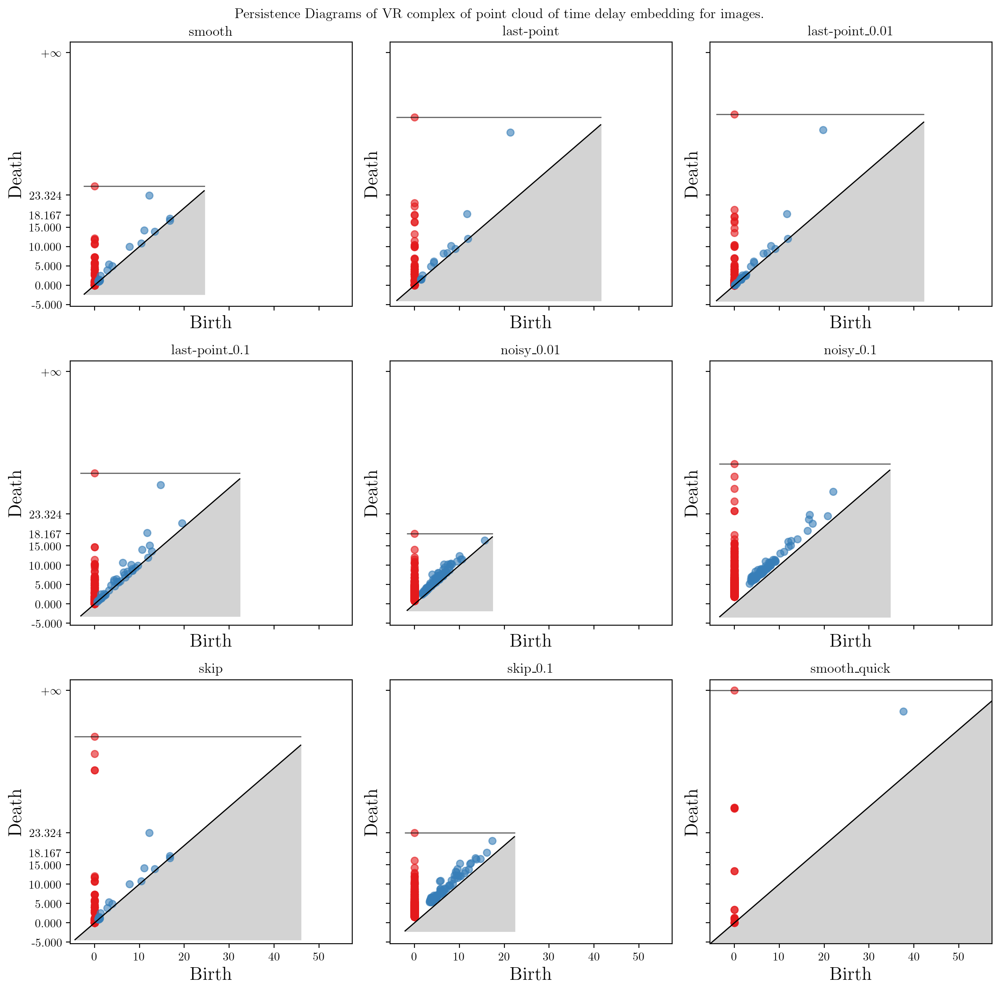

In [43]:
fig, ax_list = create_fig(samples_all, dpi=200, sharey=True, sharex=True)

diagrams = np.load(os.path.join(data_folder, 'persistence_diagrams', 
                                'images_consecutive_VRcomplex.npz'))

for i, key in enumerate(diagrams.keys()):
    dgmX = diagram_convert(diagrams[key])
    gd.plot_persistence_diagram(dgmX, axes=ax_list[i])
    ax_list[i].set_title('_'.join(key.split('_')[1:]))

for i in range(len(diagrams.keys()), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Persistence Diagrams of VR complex of point cloud of time delay embedding for images.')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'img_VR_timedelay.png'))

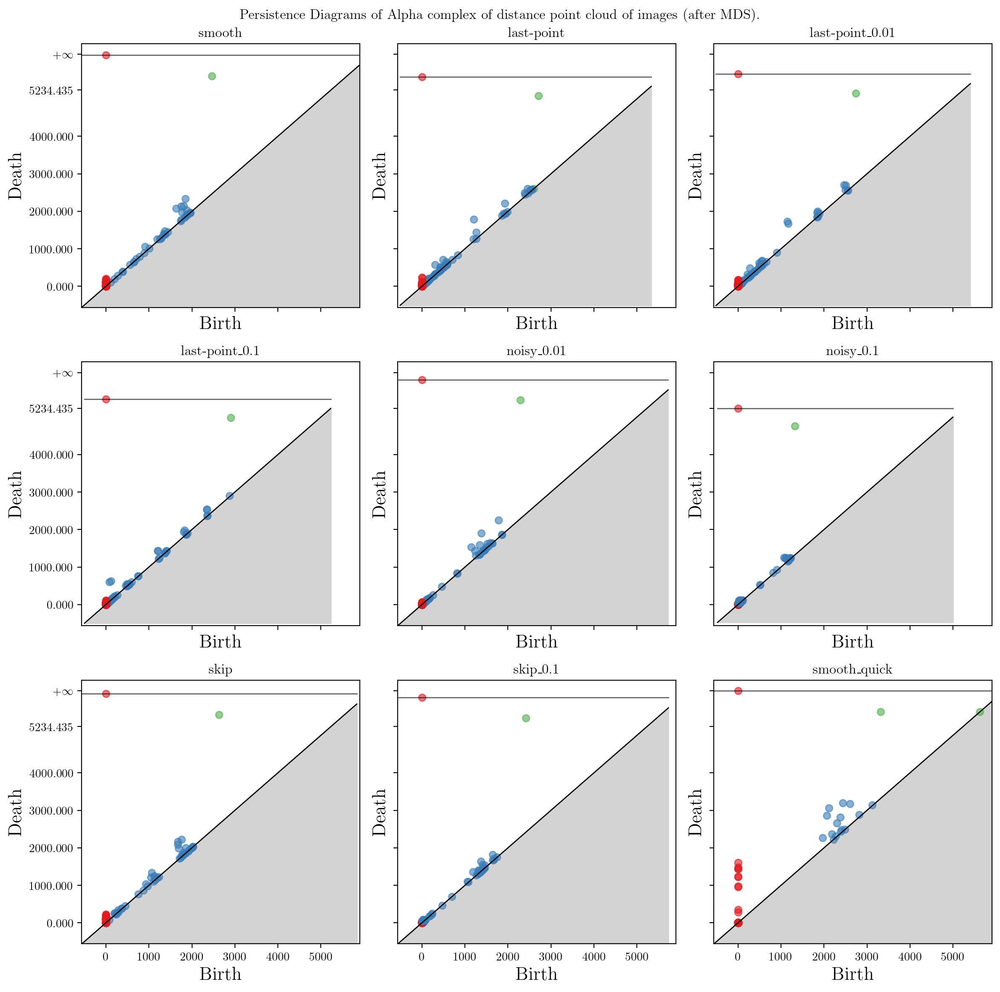

In [44]:
fig, ax_list = create_fig(samples_all, dpi=200, sharey=True, sharex=True)

diagrams = np.load(os.path.join(data_folder, 'persistence_diagrams', 
                                'images_distmatrix_alphacomplex.npz'))

for i, key in enumerate(diagrams.keys()):
    dgmX = diagram_convert(diagrams[key])
    gd.plot_persistence_diagram(dgmX, axes=ax_list[i])
    ax_list[i].set_title('_'.join(key.split('_')[1:]))

for i in range(len(diagrams.keys()), len(ax_list)):
    ax_list[i].remove()

fig.suptitle('Persistence Diagrams of Alpha complex'
             + ' of distance point cloud of images (after MDS).')
fig.tight_layout()
# fig.savefig(os.path.join(data_folder, 'plots', 'img_alpha_pwDistances.png'))

## Persistence Diagrams differences

In [52]:
dirpath = os.path.join(data_folder, 'persistence_diagrams')
df_dist = pd.read_csv(os.path.join(dirpath, 'diagram_distances.csv'))

value_text = {'bottleneck': 'Bottleneck distance',
              'wasserstein': 'Wasserstein distance',
              'landscape': 'L2 distance of landscapes',
              'entropy': 'absolute difference between entropy'
             }

combs_idx = ['point_diff', 'complex', 'embedding']
combs = df_dist.set_index(combs_idx).index.unique()
combs

# make it so that 'smooth' is the first in the keys list
keys = list(np.unique(np.stack([df_dist['key_0'], df_dist['key_1']])))
if 'smooth' in keys:
    keys.remove('smooth')
    keys.insert(0, 'smooth')

100%|██████████| 7/7 [00:07<00:00,  1.12s/it]


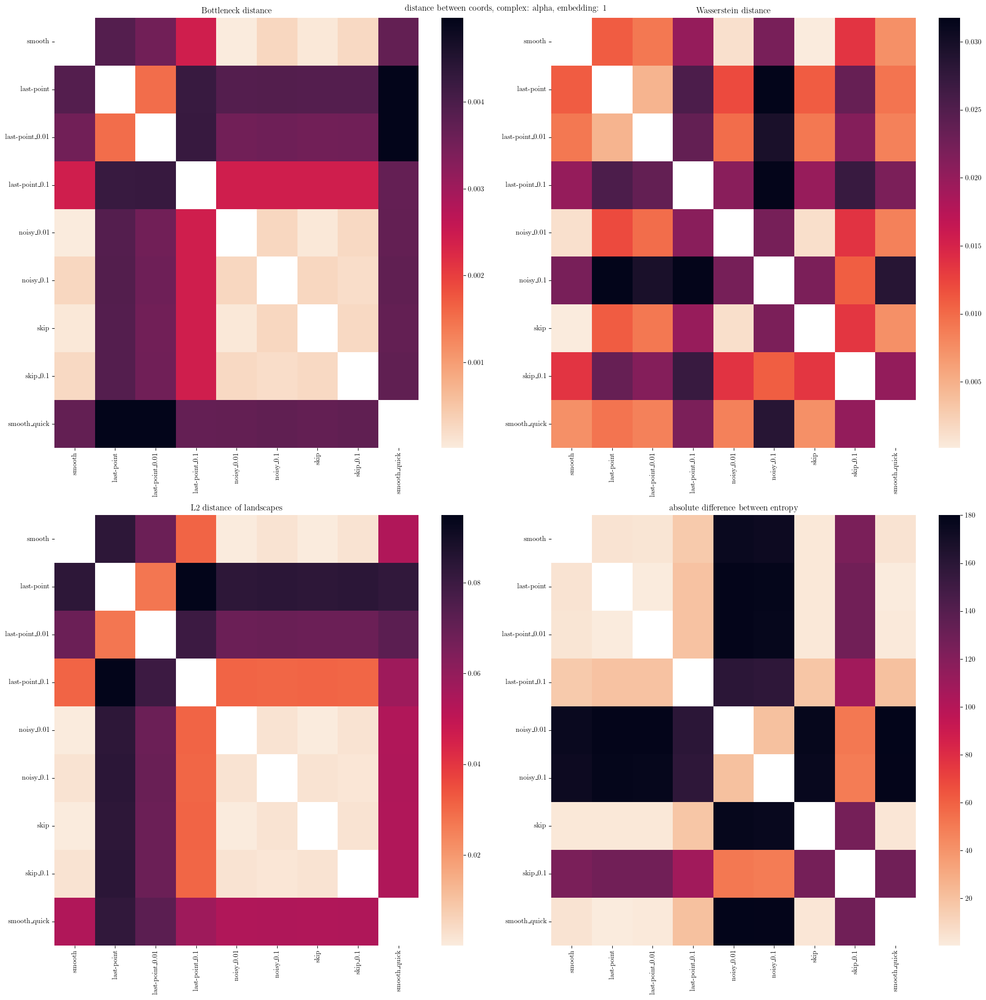

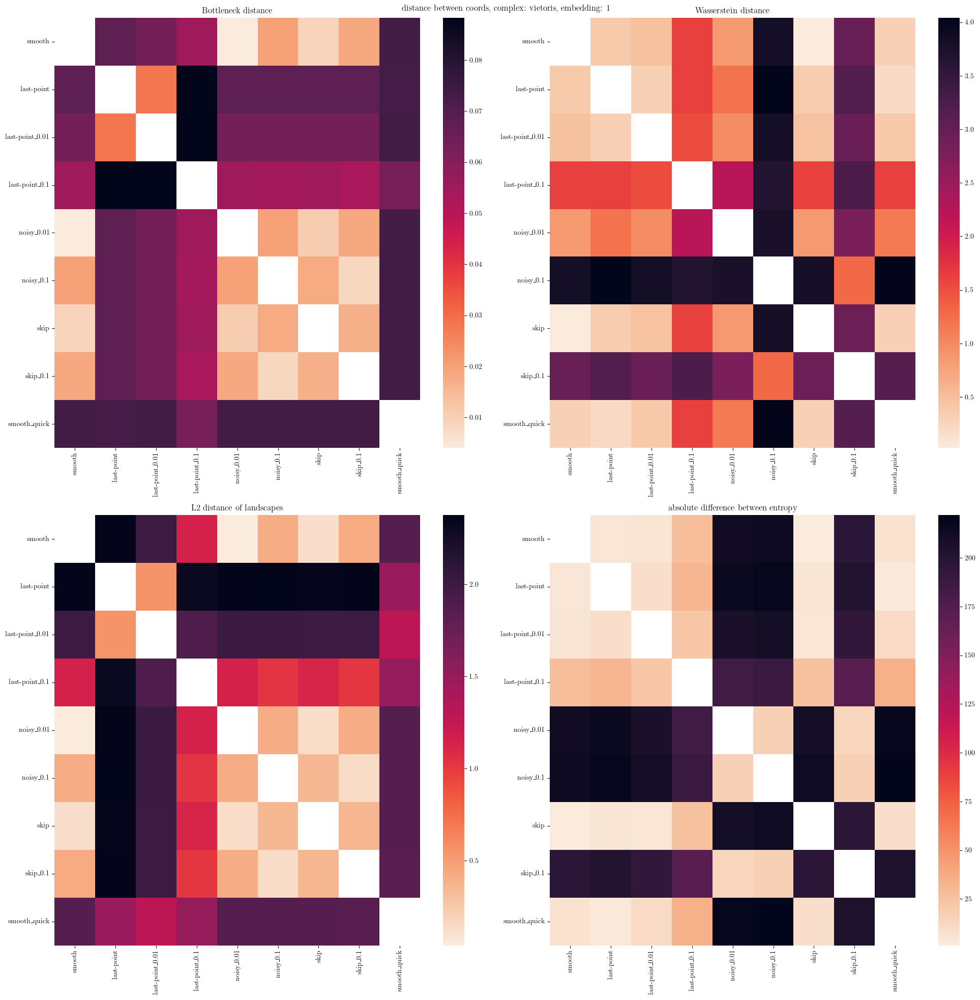

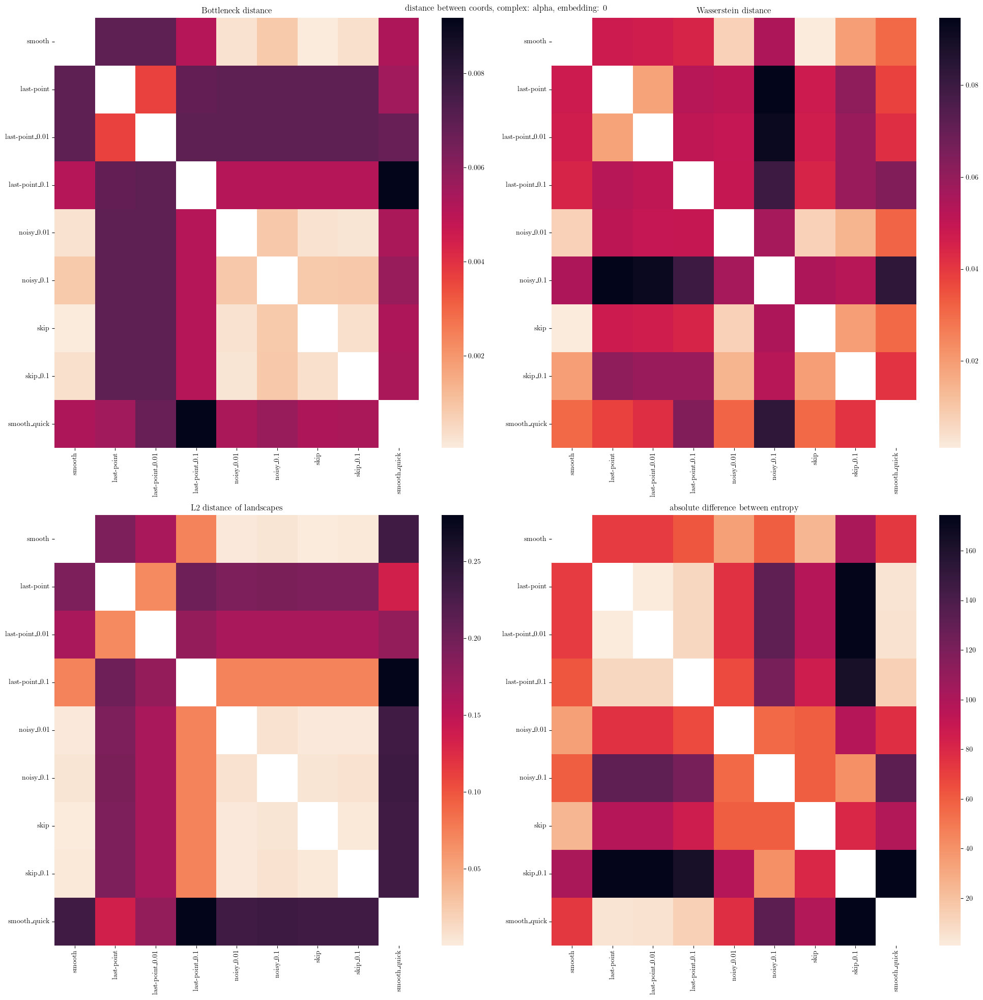

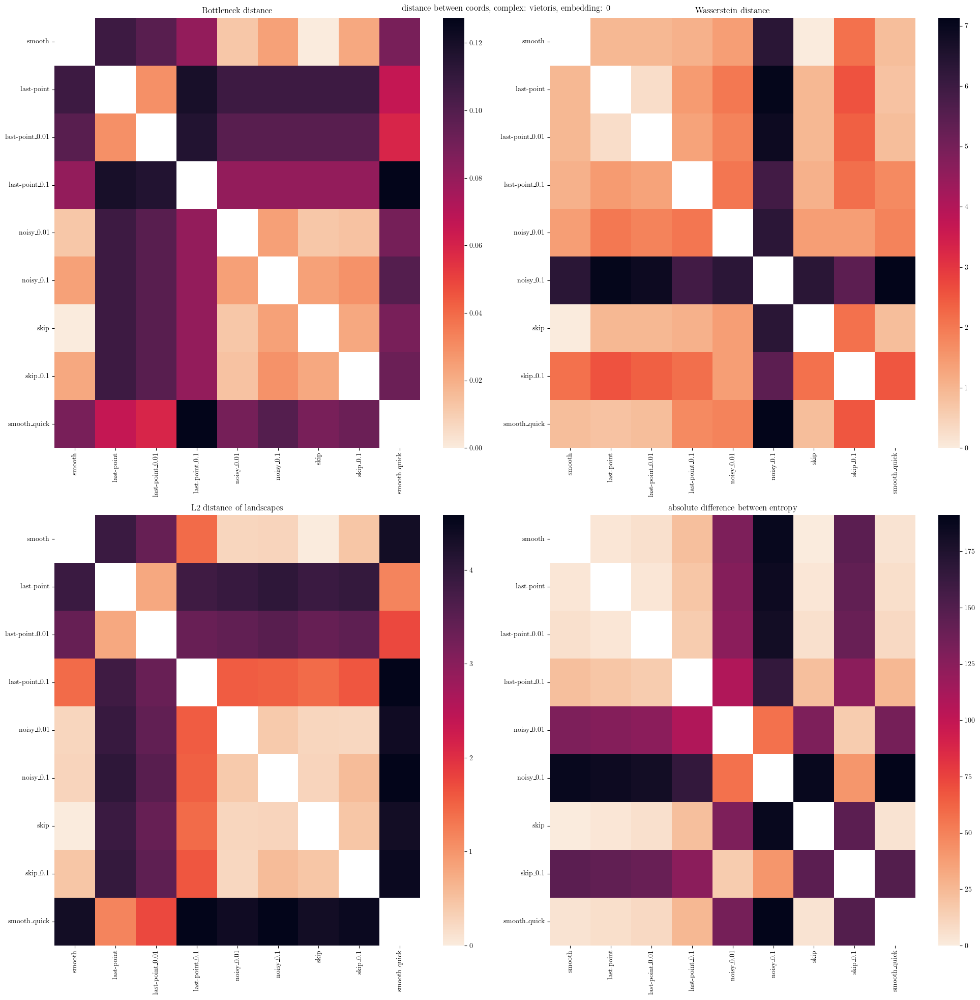

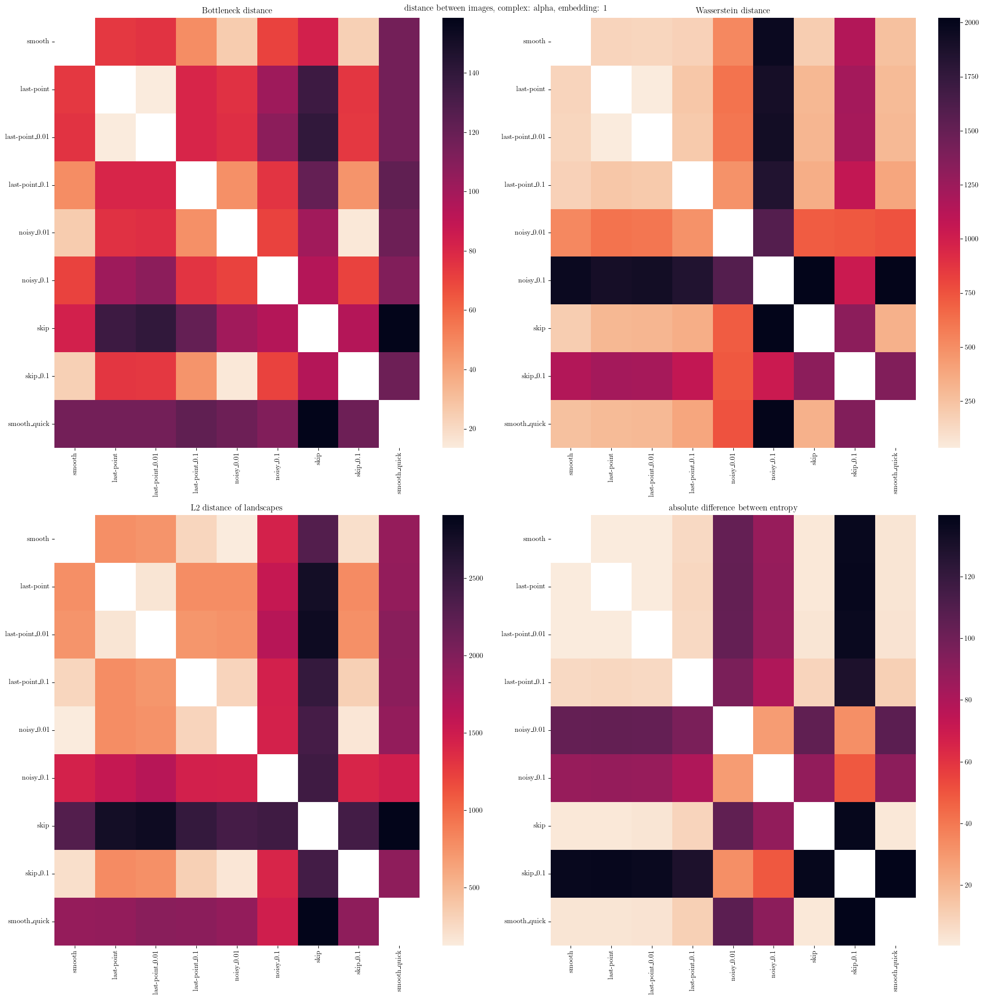

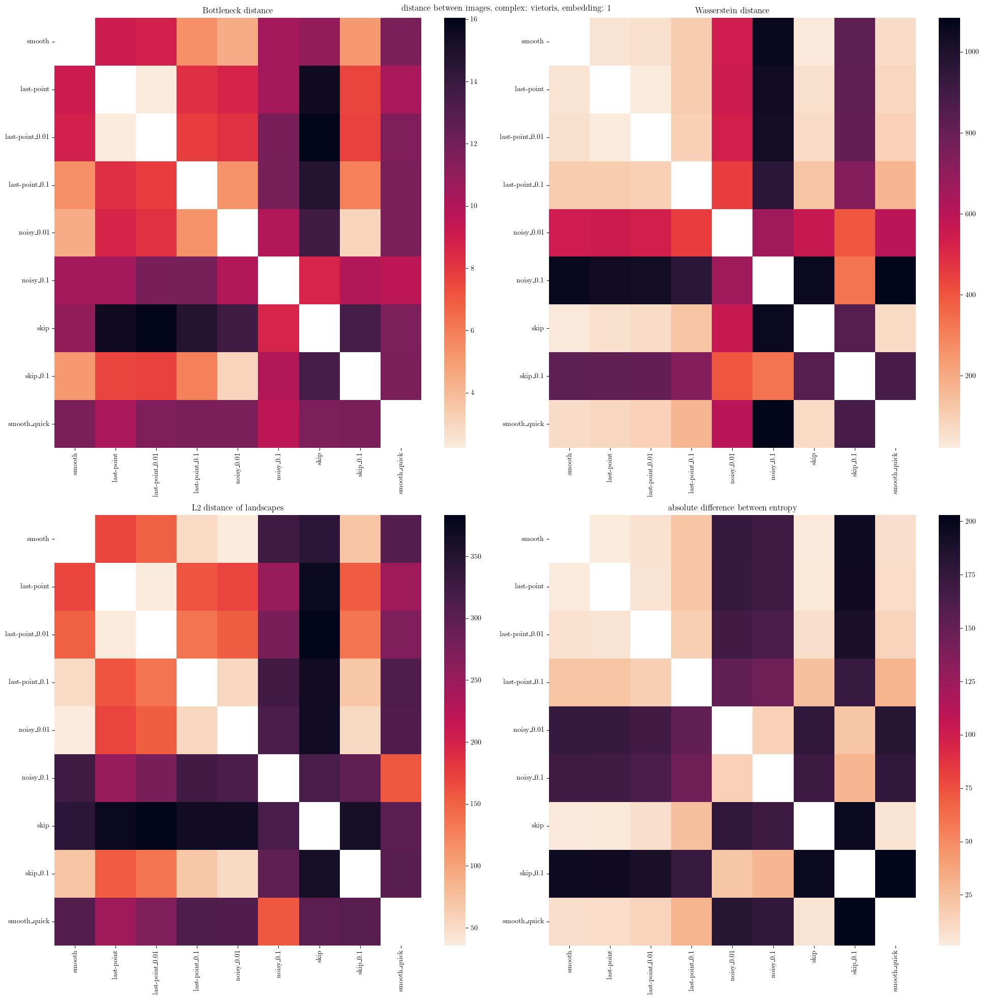

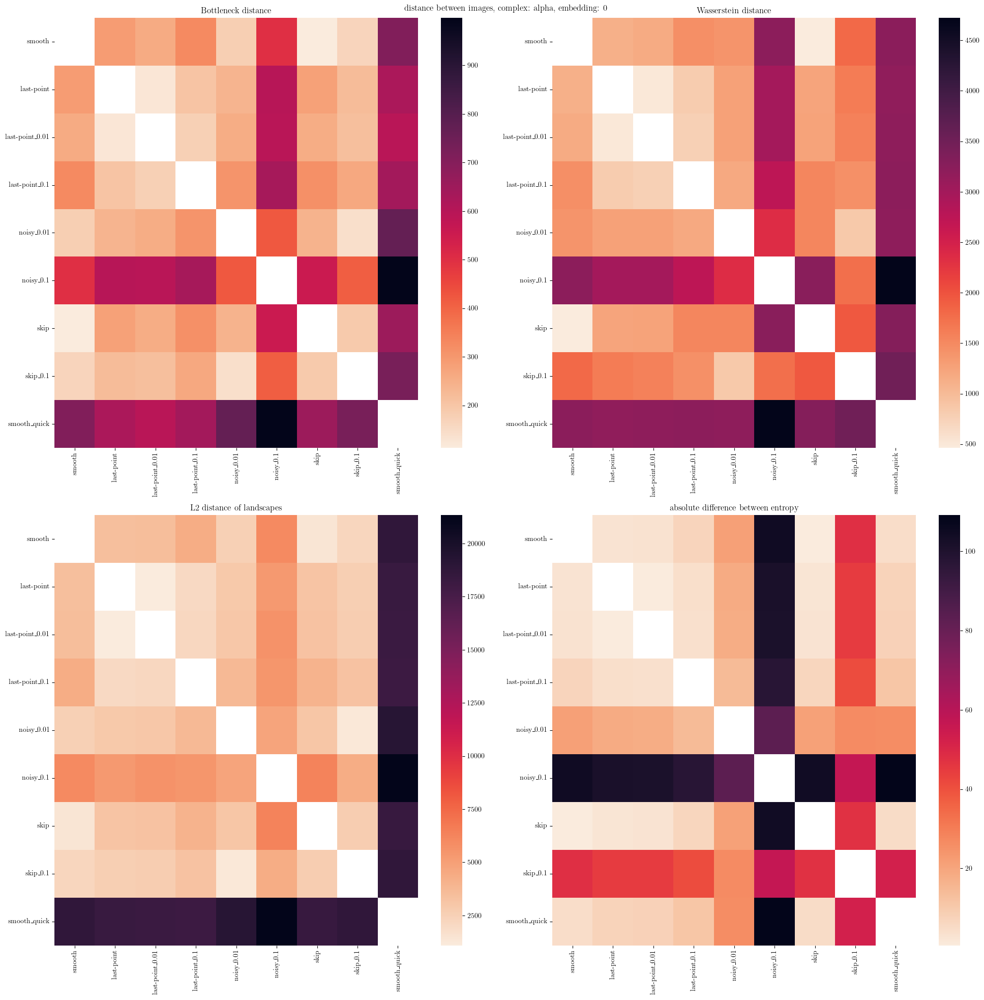

In [53]:
for unique_combs in tqdm(combs):
    df_combs = df_dist.loc[(df_dist['point_diff']==unique_combs[0])
                         & (df_dist['complex']==unique_combs[1])
                         & (df_dist['embedding']==unique_combs[2])]
    if len(df_combs) == 0:
        print(unique_combs, 'empty')
        continue

    fig, ax = plt.subplots(2, 2, dpi=100, figsize=(20,20))
    for key_i, key in enumerate(value_text):
        axi = ax[np.unravel_index(key_i, [2, 2])]

        df = df_combs.pivot_table(values=key,
                                  index="key_0",
                                  columns="key_1",
                                  aggfunc=np.mean)

        # make into a proper distance matix and sort the columns
        new_col = set(df.index).difference(set(df.columns)).pop()
        df.loc[:, new_col] = df.loc[new_col]

        new_idx = set(df.columns).difference(set(df.index)).pop()
        df.loc[new_idx] = df.loc[:, new_idx]

        df = df.loc[keys, keys]

        # fill out all entries
        for j in range(len(keys)):
            for i in range(j, len(keys)):
                if i == j:
                    df.loc[keys[i], keys[i]] = None
                else:
                    df.loc[keys[i], keys[j]] = df.loc[keys[j], keys[i]]

        # now plot it with reverse color map
        sns.heatmap(df, ax=axi, cmap=sns.cm.rocket_r)

        axi.set_xlabel('')
        axi.set_ylabel('')

        axi.set_title(value_text[key])

    fig.suptitle(f'distance between {unique_combs[0]}, complex: {unique_combs[1]}, embedding: {unique_combs[2]}')
    fig.tight_layout()
    
    # fig.savefig(f'./{data_folder}/plots/distances_persistence_diagram_{unique_combs[0]}_{unique_combs[1]}_{unique_combs[2]}.png')
    # plt.close(fig)

100%|██████████| 7/7 [00:15<00:00,  2.25s/it]


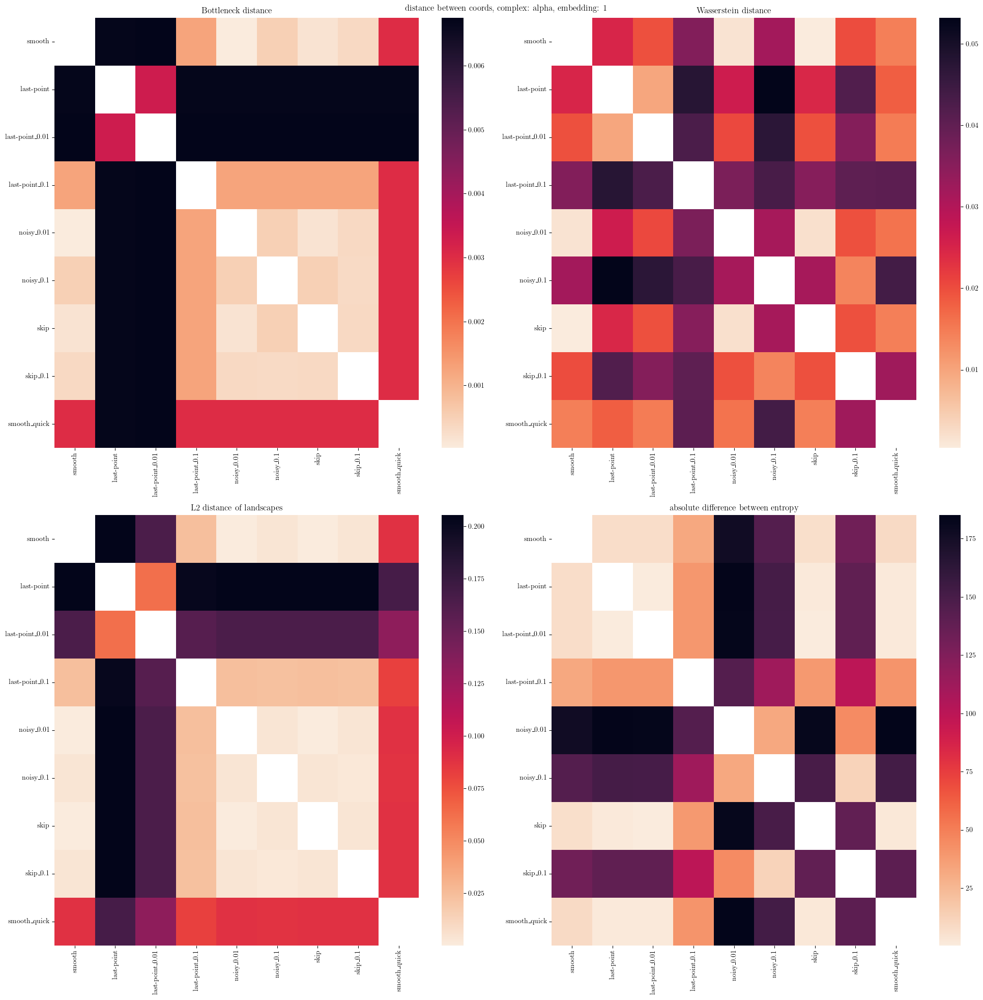

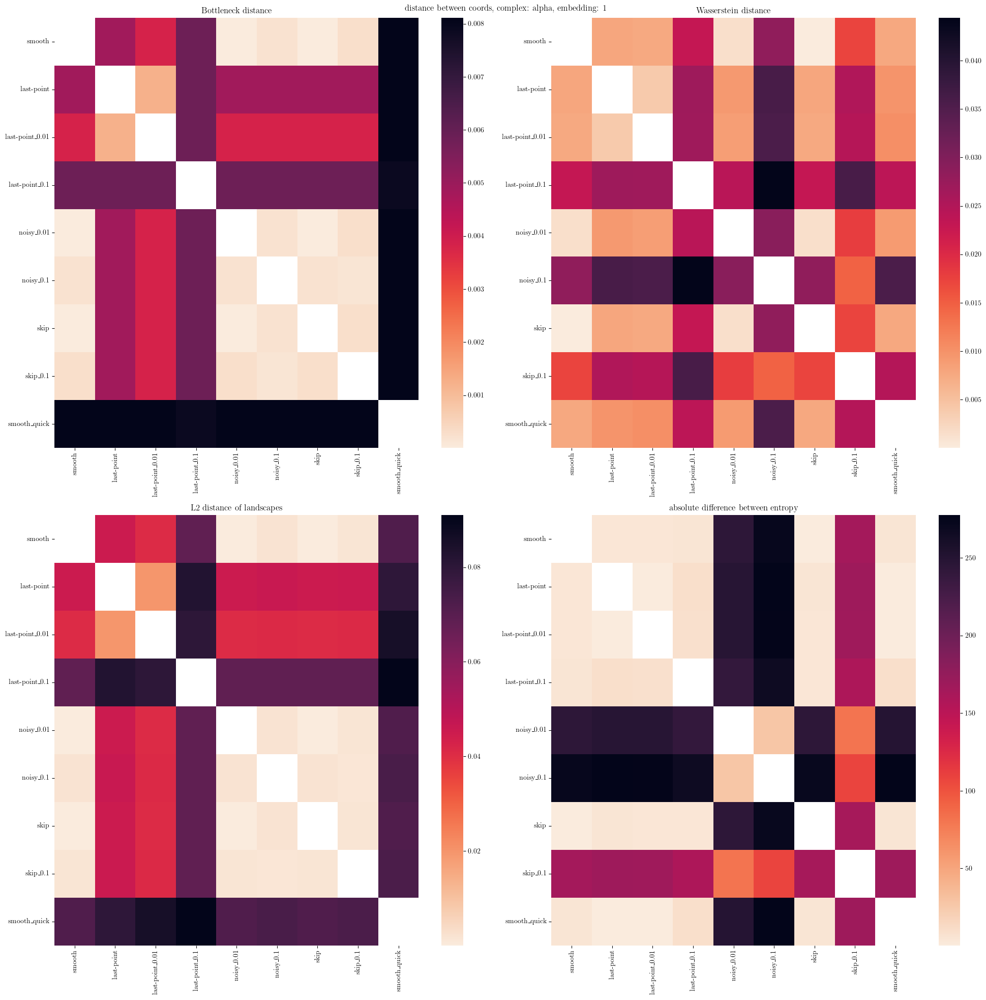

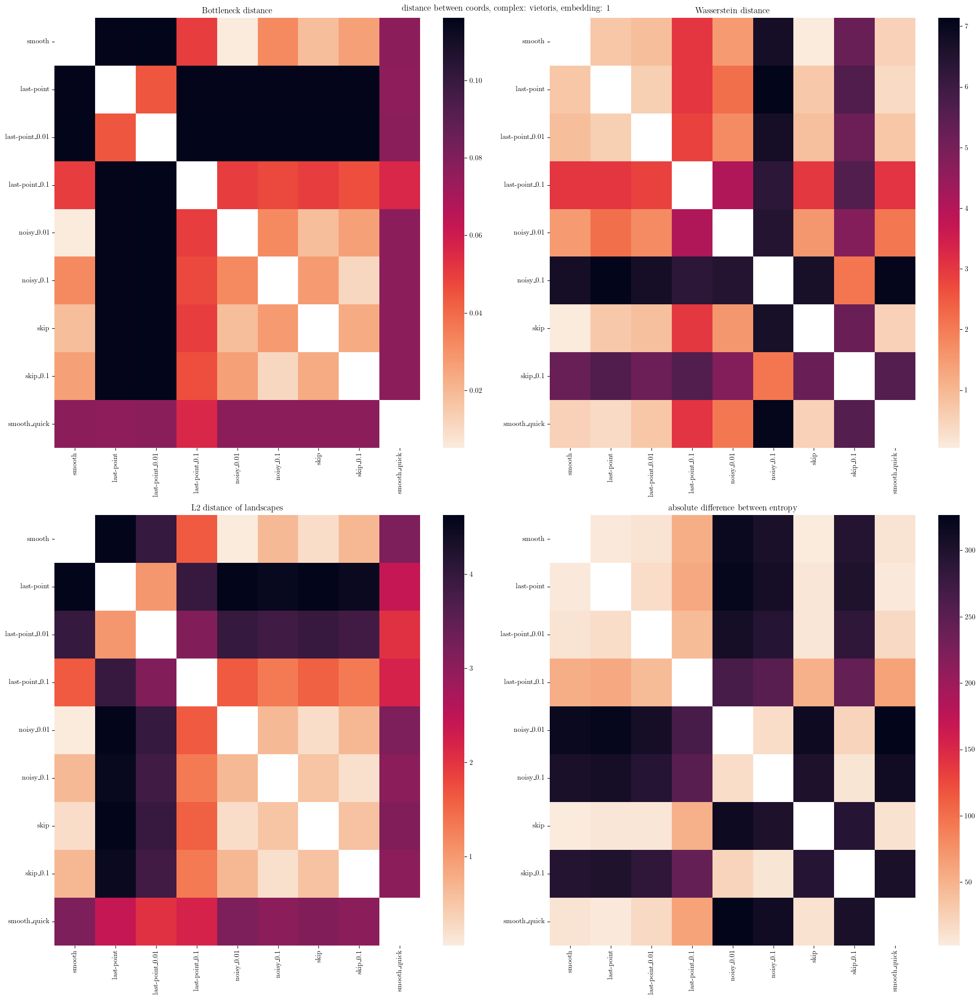

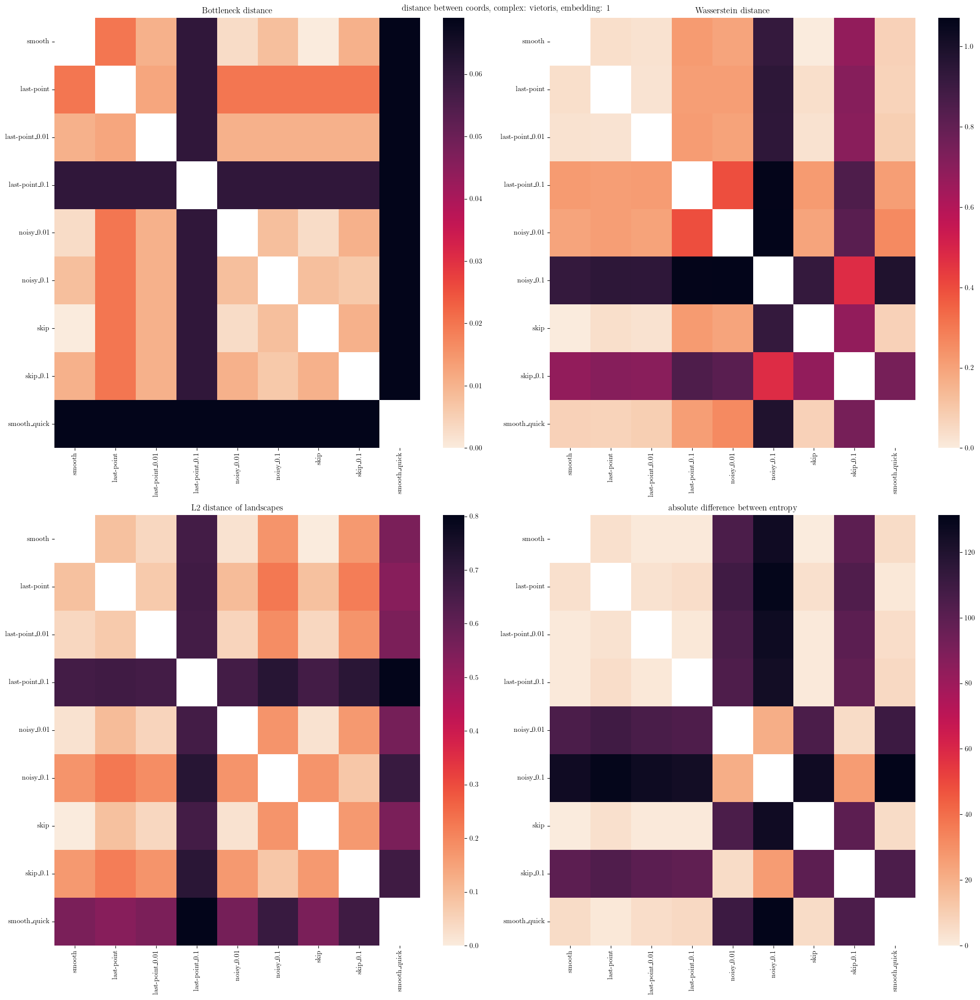

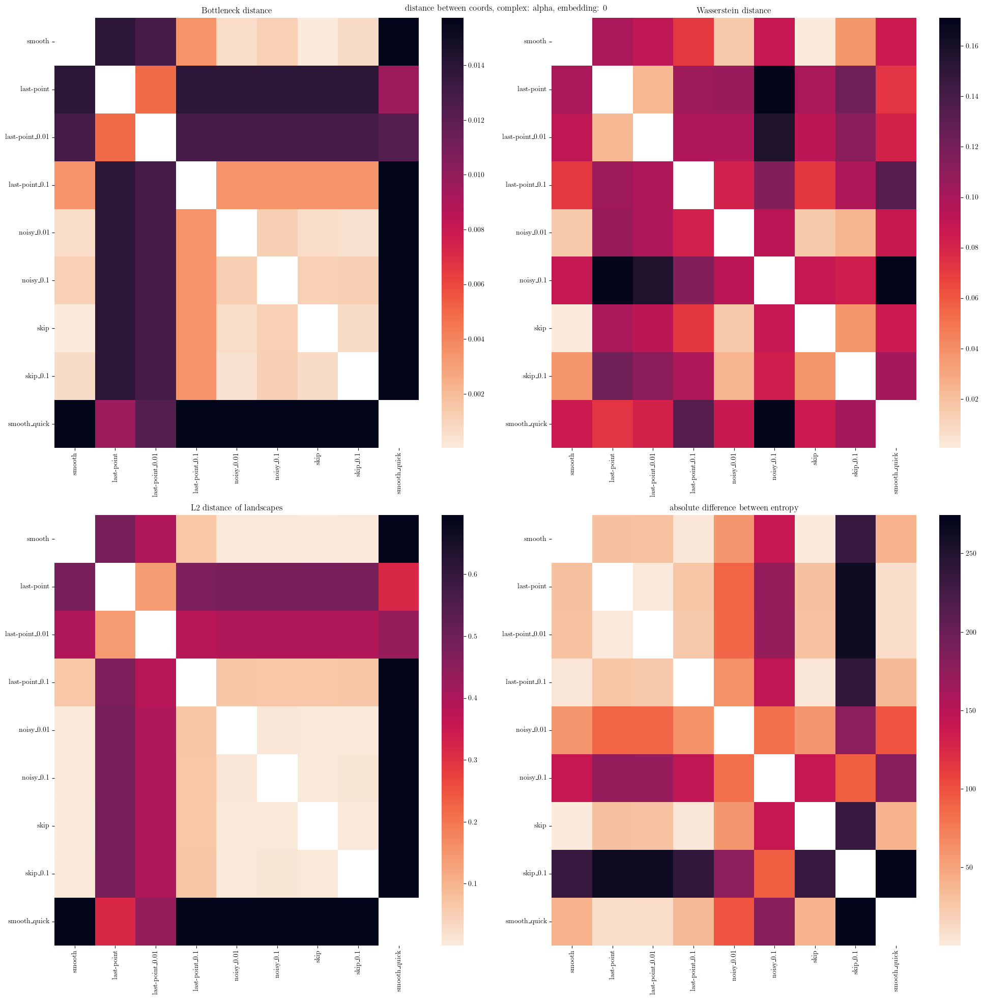

...

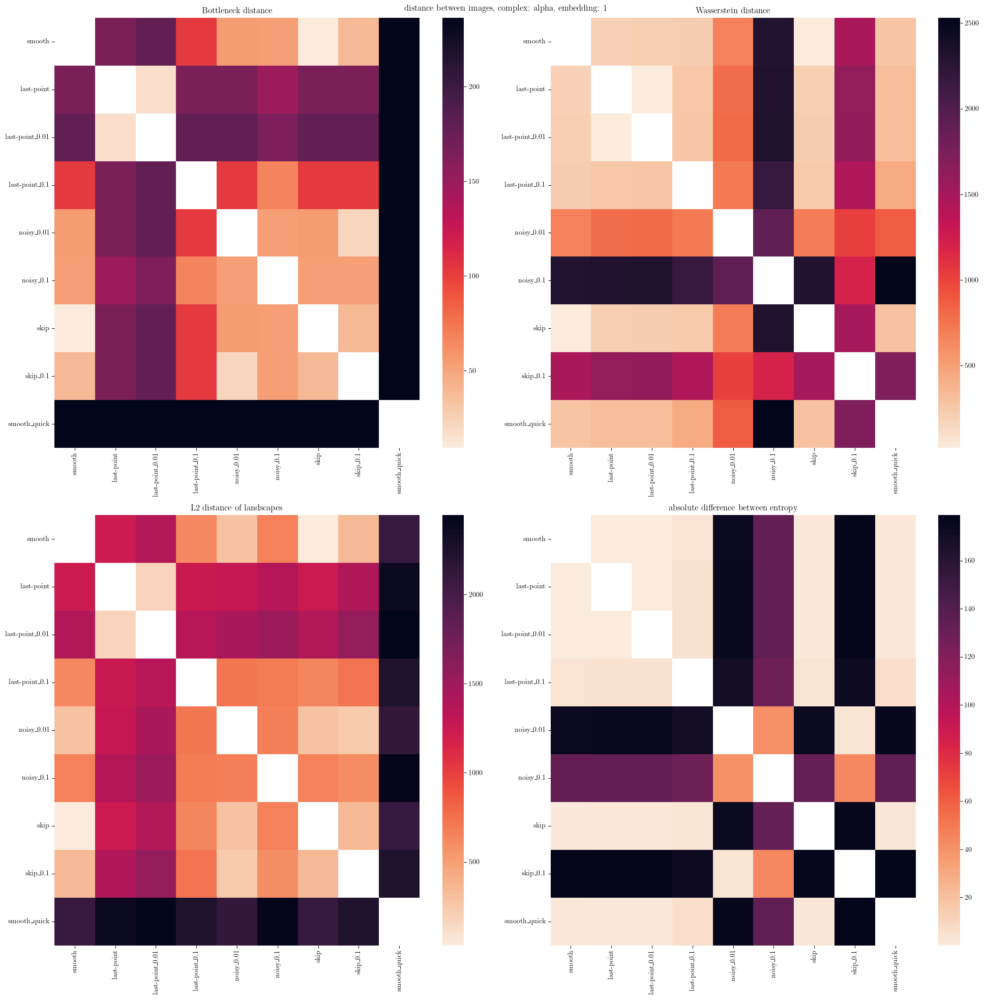

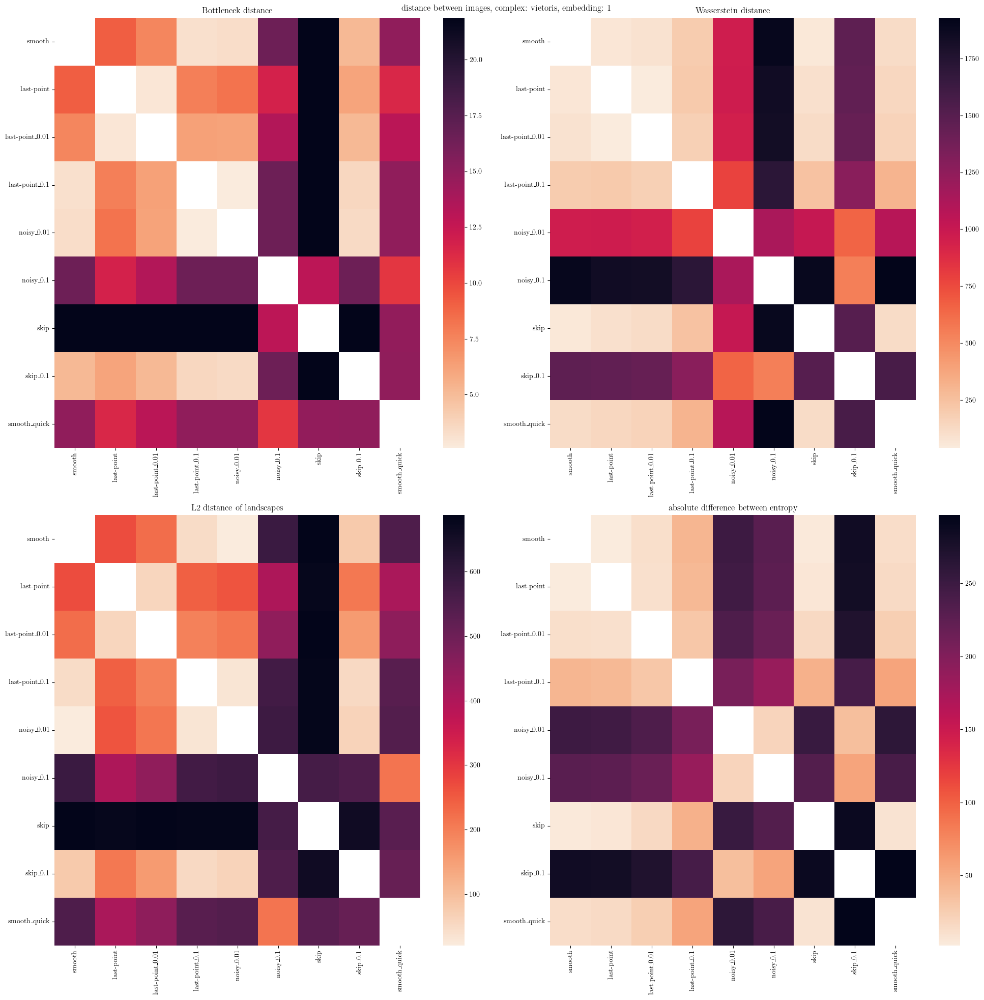

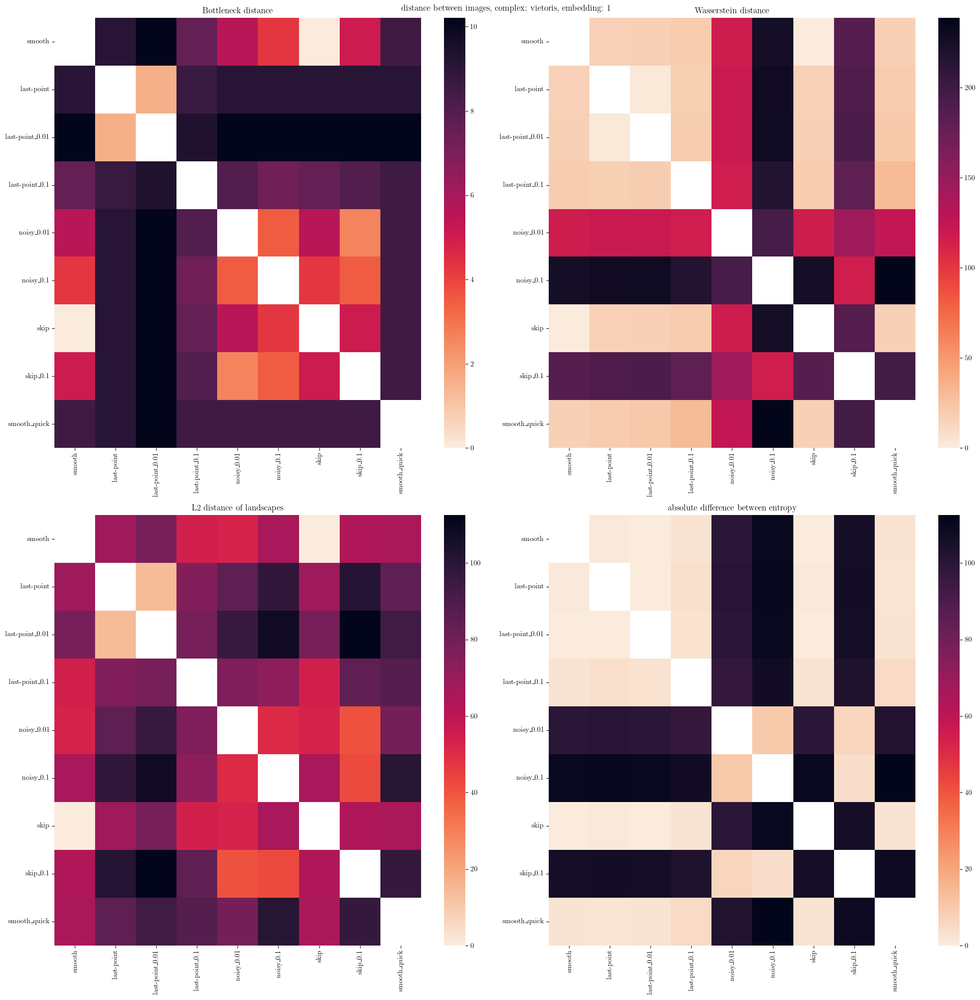

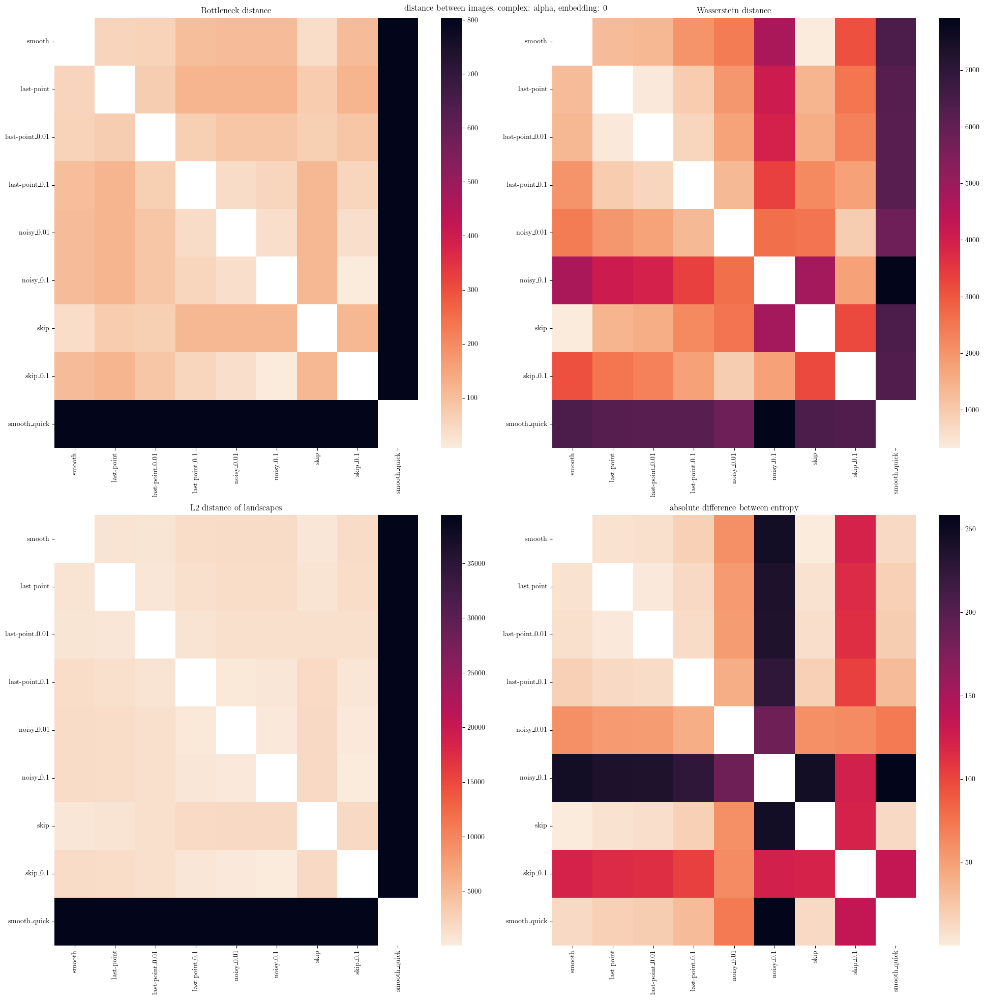

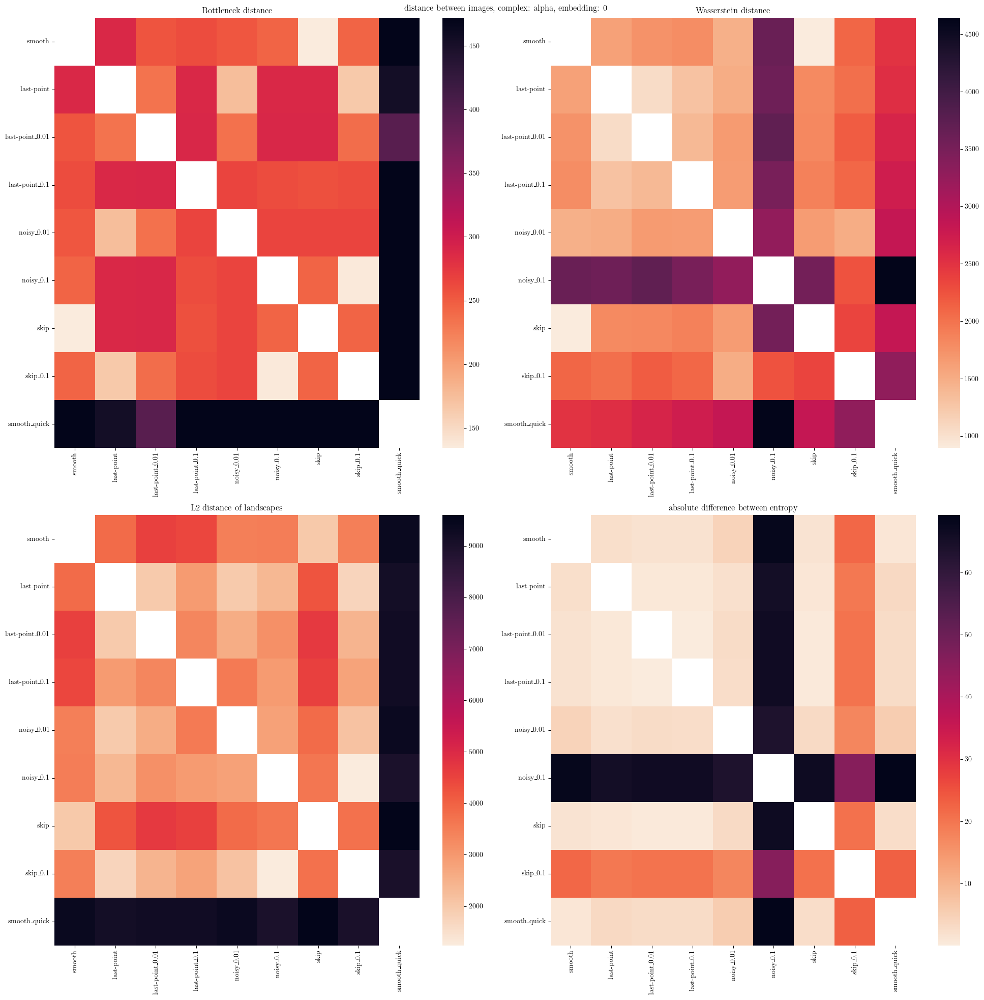

In [54]:
for unique_combs in tqdm(combs):
    for dim in [0,1]:
        df_combs = df_dist.loc[(df_dist['point_diff']==unique_combs[0])
                                & (df_dist['complex']==unique_combs[1])
                                & (df_dist['embedding']==unique_combs[2])
                                & (df_dist['dim']==dim)]
        if len(df_combs) == 0:
            print(unique_combs, 'empty')
            continue

        fig, ax = plt.subplots(2, 2, dpi=100, figsize=(20,20))
        for key_i, key in enumerate(value_text):
            axi = ax[np.unravel_index(key_i, [2, 2])]

            df = df_combs.pivot_table(values=key,
                                    index="key_0",
                                    columns="key_1")

            # make into a proper distance matix and sort the columns
            new_col = set(df.index).difference(set(df.columns)).pop()
            df.loc[:, new_col] = df.loc[new_col]

            new_idx = set(df.columns).difference(set(df.index)).pop()
            df.loc[new_idx] = df.loc[:, new_idx]

            df = df.loc[keys, keys]

            # fill out all entries
            for j in range(len(keys)):
                for i in range(j, len(keys)):
                    if i == j:
                        df.loc[keys[i], keys[i]] = None
                    else:
                        df.loc[keys[i], keys[j]] = df.loc[keys[j], keys[i]]

            # now plot it with reverse color map
            sns.heatmap(df, ax=axi, cmap=sns.cm.rocket_r)

            axi.set_xlabel('')
            axi.set_ylabel('')

            axi.set_title(value_text[key])

        fig.suptitle(f'distance between {unique_combs[0]}, complex: {unique_combs[1]}, embedding: {unique_combs[2]}')
        fig.tight_layout()

        # fig.savefig(f'./{data_folder}/plots/distances_persistence_diagram_{unique_combs[0]}_{unique_combs[1]}_{unique_combs[2]}_dim{dim}.png')
        # plt.close(fig)

In [57]:
df_norm = df_dist.loc[(df_dist['key_0']=='smooth') 
                      & (df_dist['dim'].isin([0,1]))].\
                    set_index(['point_diff', 'complex', 
                               'embedding', 'dim'])
idx = df_norm.index.unique()

dist_types = ['bottleneck', 'wasserstein', 'landscape', 'entropy']
# MinMaxScaler().fit_transform(df_norm.loc[idx[0], ['bottleneck']].values)
for i in idx:
  df_norm.loc[i, dist_types] = MinMaxScaler().fit_transform(df_norm.loc[i, dist_types].values)

df_sort = df_norm.loc[(df_norm['key_0']=='smooth')].\
                    drop(columns='key_0').reset_index()
df_sort['key_1'].replace({key: keys.index(key) for key in keys[1:]}, inplace=True)
df_sort = df_sort.set_index(['point_diff', 'complex', 'embedding', 'dim', 'key_1']).mean(axis=1).reset_index()
df_sort = df_sort.set_index(['point_diff', 'complex', 'embedding', 'dim'])

idx_sort = df_sort.index.unique()
df_sort = df_sort.sort_values(by=0)
df_sort

data_sort = []
annot_sort = []
for idx in idx_sort:
    data_sort.append(df_sort.loc[idx, 'key_1'].values)
    annot_sort.append(df_sort.loc[idx, 0].values)

data_sort = np.array(data_sort)
annot_sort = np.array(annot_sort)

C:\Users\Jan\AppData\Local\Temp\ipykernel_9540\2905378351.py:10: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_norm.loc[i, dist_types] = MinMaxScaler().fit_transform(df_norm.loc[i, dist_types].values)
C:\Users\Jan\AppData\Local\Temp\ipykernel_9540\2905378351.py:10: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_norm.loc[i, dist_types] = MinMaxScaler().fit_transform(df_norm.loc[i, dist_types].values)
C:\Users\Jan\AppData\Local\Temp\ipykernel_9540\2905378351.py:10: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_norm.loc[i, dist_types] = MinMaxScaler().fit_transform(df_norm.loc[i, dist_types].values)
C:\Users\Jan\AppData\Local\Temp\ipykernel_9540\2905378351.py:10: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_norm.loc[i, dist_types] = MinMaxScaler().fit_transform(df_norm.loc[i, dist_types].values)
C:\Users\Jan\AppData\Local\Temp\ipykernel_9540\2905378351.py:10: Perform

C:\Users\Jan\AppData\Local\Temp\ipykernel_9540\263571007.py:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.collections[0].colorbar.set_ticklabels(keys)


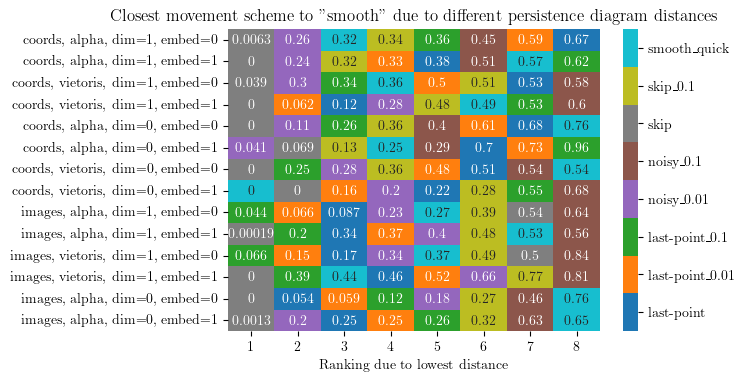

In [60]:
cmap = mpl.cm.get_cmap("tab10", 8)

fig, ax = plt.subplots(1, 1, dpi=100)
sn = sns.heatmap(data=data_sort, 
            annot=annot_sort,
            cmap=cmap,
            # cmap=plt.cm.get_cmap('jet', 8),
            ax=ax,
            vmin = 0.5, vmax = 8.5,
            cbar_kws=dict(cmap=cmap)
            )
            # cbar_kws = dict(use_gridspec=False, location="left"))
ax.collections[0].colorbar.set_ticklabels(keys)

ax.set_yticklabels([f'{idx[0]}, {idx[1]}, dim={idx[2]}, embed={idx[3]}' 
                    for idx in idx_sort], 
                   rotation=0, ha='right', rotation_mode='anchor')

ax.set_xticklabels(range(1, 9))
ax.set_xlabel('Ranking due to lowest distance')

ax.set_title('Closest movement scheme to "smooth" due to different persistence diagram distances');